# BreastDCEDL 
## BreastDCEDL Data load and Visualize

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/naomifridman/BreastDCEDL/blob/main/BrestDCEDL_demo_on_local_data_min_crop.ipynb)


#### Author: Bubby Solway
#### Date: 2025-09-22
> BreastDCEDL/BrestDCEDL_demo_on_local_data_min_crop.ipynb


In [120]:
from sklearn.metrics import classification_report,auc,roc_auc_score
from PIL import Image
import time
from pathlib import Path


import os
import numpy as np
import pandas as pd
from PIL import Image


import warnings
warnings.filterwarnings('ignore', '.*do not.*', )
warnings.warn('Do not show this message')

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

from glob import glob
#from skimage import io
from sklearn.utils import shuffle

#from nipype.interfaces.ants import N4BiasFieldCorrection
import sys
import os
import ast
import re
import nibabel as nib
import warnings
warnings.filterwarnings('ignore')

In [121]:
def show_n_images(
    imgs,
    cmap="gray",
    titles=None,
    enlarge=4,
    mtitle=None,
    cut=False,
    axis_off=True,
    fontsize=15,
    cb=False,
):
    """Visualise *n* images side-by-side."""
    _ = plt.figure(figsize=(enlarge * len(imgs), enlarge * 2))
    for i, im in enumerate(imgs, 1):
        ax = plt.subplot(1, len(imgs), i)
        if cb and len(np.unique(im)) > 5:
            im = cont_br(im)
        ax.imshow(im[50:290, 75:450] if cut else im, cmap=cmap, origin="lower")
        if titles is not None:
            ax.set_title(titles[i - 1], fontsize=fontsize)
        if axis_off:
            ax.axis("off")
    if mtitle:
        plt.suptitle(mtitle, fontsize=fontsize + 2)
    plt.tight_layout(); plt.show()


In [194]:
# --------------------------------------------------------------------- #
#                       NIfTI I/O utilities                             #
# --------------------------------------------------------------------- #
NIFTI_SUFFIX = {
    "spy2": "_spy2_vis1_dce_aqc_",
    "spy1": "_spy1_vis1_dec_acq_",
    "duke": "_duke_aqc_",
}
MASK_SUFFIX = {
    "spy2": "_spy2_vis1_mask",
    "spy1": "_spy1_vis1_mask",
}
def _ds_from_pid(pid: str) -> str:
    if "ISPY1" in pid:
        return "spy1"
    if ("ISPY2" in pid) or ("ACRIN-6698" in pid):
        return "spy2"
    if "Breast_MRI" in pid:
        return "duke"
    raise ValueError(f"Cannot infer dataset for pid={pid!r}")


def _build_file(pid: str, idx:  int, kind="dce") -> str:
    ds   = _ds_from_pid(pid)
    if kind=='dce':
        root = nifti_path[ds]
        suf  = NIFTI_SUFFIX[ds]
        return os.path.join(root, f"{pid}{suf}{idx}.nii.gz")
    else:
        root = mask_path[ds]
        suf  = MASK_SUFFIX[ds]
        return os.path.join(root, f"{pid}{suf}.nii.gz")

def read_nifti(path: str) -> np.ndarray:
    return nib.load(path).get_fdata()

def _last_int(path):
    m = re.search(r"(\d+)\.nii\.gz$", path)
    return int(m.group(1)) if m else -1


def get_all_nifti_acquisitions(pid: str, fpath=None):
    
    if fpath != None:
        x=os.listdir(fpath)
        x=[c for c in x if pid in c]
        files = sorted(x, key=_last_int)
        if deb: print(files)
        return [read_nifti(os.path.join(fpath,f)) for f in files]
    ds   = _ds_from_pid(pid)
    if deb: print(ds, nifti_path[ds])
    patt = os.path.join(nifti_path[ds], f"{pid}{NIFTI_SUFFIX[ds]}*.nii.gz")
    if deb: print(patt)
    files = sorted(glob(patt), key=_last_int)
    if deb: print(files)
    return [read_nifti(f) for f in files]

def get_sorted_nifti_acquisitions(pid):
    
    ds   = _ds_from_pid(pid)
    
    data_path = nifti_path[ds]
    if deb: print(ds, nifti_path[ds])
        
    ff = [x for x in os.listdir(data_path) if pid in x]
    if deb:print(os.listdir(data_path)[:7],pid)
    if deb:print(ff)
    sorted_filenames = sorted(ff, key=_last_int)
    
    img = []
    for f in sorted_filenames:
        x = read_nifti(os.path.join(data_path, f))
        img.append(x)
        
    return img

def get_nifti_mask(pid: str):
    f = _build_file(pid, 0, kind="mask")  # mask has no trailing idx
    if deb: print(f)
    return read_nifti(f) if os.path.isfile(f) else None



In [180]:
def minmax(m):
    if m.max()==0:
        return m
    m = (m-m.min())/(m.max()-m.min())
    return m

def to_rgb(a,b,c):
    
    stack_axis = a.ndim

    # Stack along the next axis
    im = np.stack([minmax(a), minmax(b), minmax(c)], axis=stack_axis)

    return im

In [124]:
# set to base of your nifti data
data_path="G:\\My Drive\\breast_mri"

In [125]:
# Check if running in Google Colab

if 'google.colab' in str(get_ipython()):
    
    !from google.colab import drive
    drive.mount('/content/drive')

    data_path='/content/drive/MyDrive/breast_mri/'

In [200]:
# Set up your local nifti path's

nifti_path= {'spy2':os.path.join(data_path,"SPY2","vis1","v5_crop_min"),
                        'spy1':os.path.join(data_path,"SPY1","vis1","v5_crop_min"),
                        'duke':os.path.join(data_path,"DUKE","crop_min_dce")}

mask_path={'spy2':os.path.join(data_path,"SPY2","vis1","crop_min_mask"),
                    'spy1':os.path.join(data_path,"SPY1","vis1","v5_crop_min_mask")
                    }

## Load and view metada

In [141]:
df=pd.read_csv('BreastDCEDL_metadata_min_crop.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2072 entries, 0 to 2071
Data columns (total 29 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   pid             2072 non-null   object 
 1   pCR             1432 non-null   float64
 2   n_xy            2072 non-null   float64
 3   n_z             2072 non-null   float64
 4   n_times         2072 non-null   float64
 5   pre             2072 non-null   float64
 6   post_early      2072 non-null   float64
 7   post_late       2072 non-null   float64
 8   slice_thick     2072 non-null   float64
 9   xy_spacing      2072 non-null   float64
 10  mask_start      2072 non-null   float64
 11  mask_end        2072 non-null   float64
 12  sraw            2072 non-null   float64
 13  eraw            2072 non-null   float64
 14  scol            2072 non-null   float64
 15  ecol            2072 non-null   float64
 16  tum_vol         2071 non-null   float64
 17  age             2072 non-null   f

In [142]:
df.test.value_counts(dropna=False)

0.0    1533
1.0     271
2.0     268
Name: test, dtype: int64

In [143]:
df.pCR.value_counts(dropna=False)

0.0    1005
NaN     640
1.0     427
Name: pCR, dtype: int64

In [144]:
pd.crosstab(df.test,df.pCR, dropna=False)

pCR,0.0,1.0
test,,
0.0,762,321
1.0,122,53
2.0,121,53


In [145]:
pd.crosstab(df.test,df.HR, dropna=False)

HR,0.0,1.0
test,,
0.0,542,989
1.0,98,173
2.0,100,168


In [146]:
pd.crosstab(df.test,df.HER2, dropna=False)

HER2,0.0,1.0
test,,
0.0,1186,344
1.0,213,56
2.0,211,57


In [147]:
os.listdir(nifti_path['spy2'])[:8]

['ACRIN-6698-102212_spy2_vis1_dce_aqc_0.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_2.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_6.nii.gz',
 'ACRIN-6698-103939_spy2_vis1_dce_aqc_0.nii.gz',
 'ACRIN-6698-103939_spy2_vis1_dce_aqc_2.nii.gz',
 'ACRIN-6698-103939_spy2_vis1_dce_aqc_5.nii.gz',
 'ACRIN-6698-104268_spy2_vis1_dce_aqc_0.nii.gz',
 'ACRIN-6698-104268_spy2_vis1_dce_aqc_2.nii.gz']

In [148]:
os.listdir(mask_path['spy2'])[:8]

['ACRIN-6698-102212_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-103939_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-104268_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-107700_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-108969_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-115987_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-116603_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-118307_spy2_vis1_mask.nii.gz']

## I-SPY-2 example

In [149]:
df[df.pid.isin(['ACRIN-6698-102212','ISPY2-550421'])]

,pid,pCR,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,...,race_white,race_black,HR,HER2,HR_HER2_STATUS,TripleNeg,HER2pos,HRposHER2neg,dataset,test
1090,ACRIN-6698-102212,0.0,256.0,38.0,8.0,0.0,2.0,6.0,2.0,0.605500,...,1.0,0.0,0.0,0.0,TripleNeg,1.0,0.0,0.0,spy2,1.0
1732,ISPY2-550421,0.0,256.0,66.0,7.0,0.0,2.0,6.0,1.0,0.688073,...,0.0,1.0,0.0,0.0,TripleNeg,1.0,0.0,0.0,spy2,0.0


G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-102212_spy2_vis1_mask.nii.gz
dce 38 256 (42, 256, 256) mask:  2 39 (42, 256, 256)


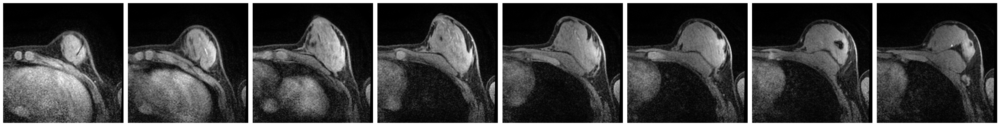

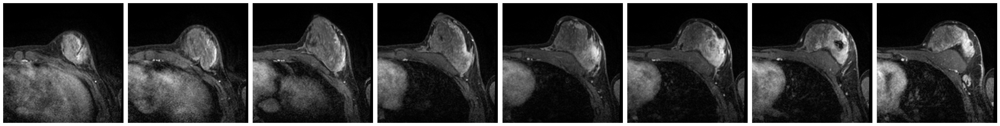

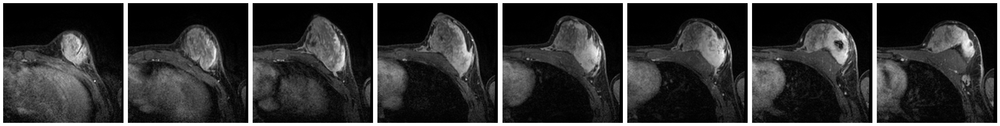

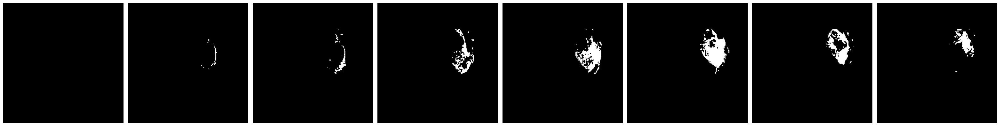

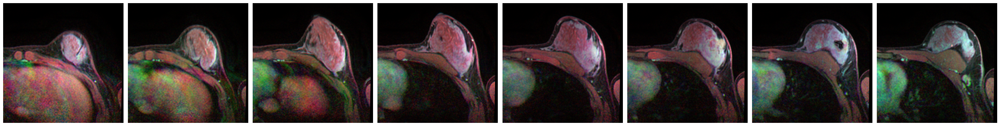

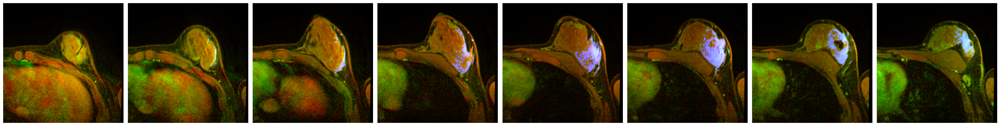

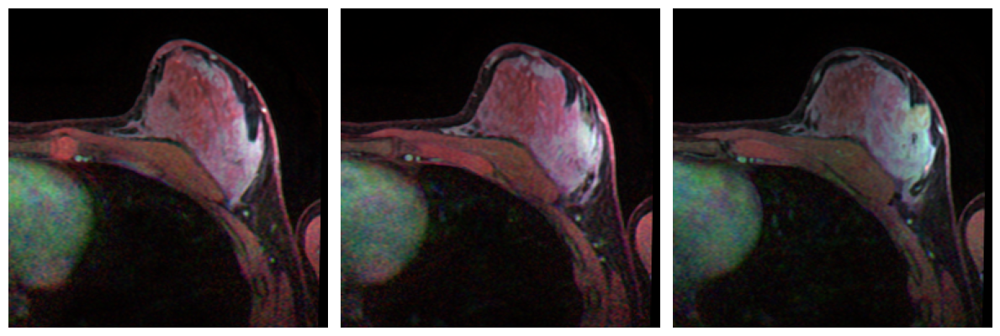

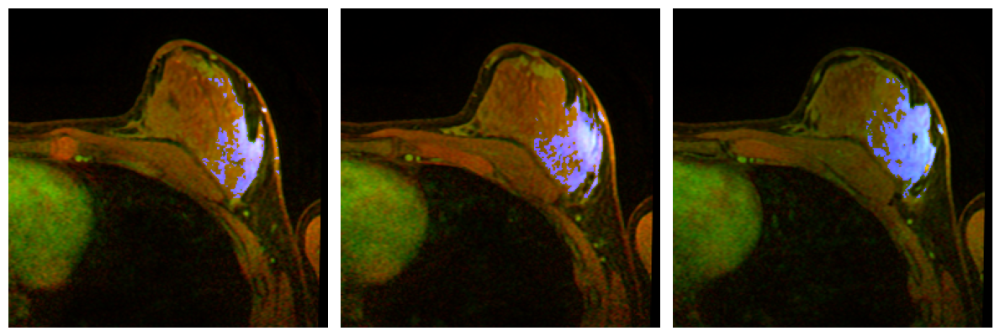

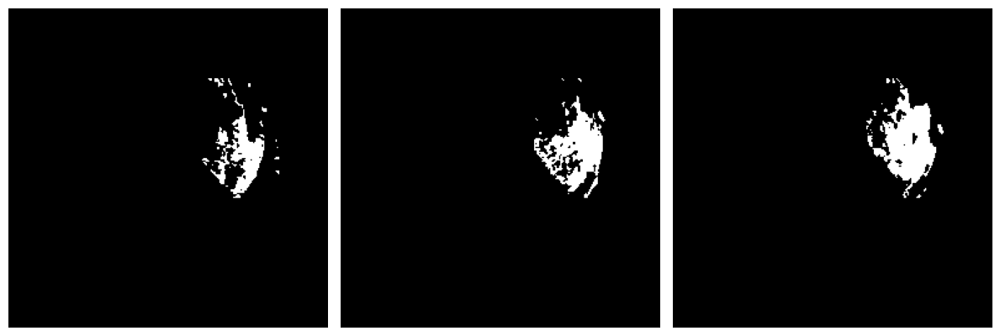

In [153]:
    
    pid='ACRIN-6698-102212'
    
    row = df[df.pid==pid].iloc[0]
    smask=int(row['mask_start'])
    emask = int(row['mask_end'])
    pmask = (smask+emask)//2
    nz=int(row['n_z'])
    nxy=int(row['n_xy'])
    
        
    d=get_all_nifti_acquisitions(pid)
    m = get_nifti_mask(pid)
    
    print('dce',nz,nxy,d[0].shape, 'mask: ', smask,emask,  m.shape)
    
    show_n_images([d[0][k] for k in range(0,nz,5)])
    show_n_images([d[1][k] for k in range(0,nz,5)])
    show_n_images([d[2][k] for k in range(0,nz,5)])
    show_n_images([m[k] for k in range(0,nz,5)])
    show_n_images([to_rgb(d[0][k],d[1][k], d[2][k]) for k in range(0,nz,5)])
    show_n_images([to_rgb(d[0][k],d[1][k], m[k]) for k in range(0,nz,5)])
    show_n_images([to_rgb(d[0][k],d[1][k], d[2][k]) for k in [pmask-3,pmask,pmask+3]])
    show_n_images([to_rgb(d[0][k],d[1][k], m[k]) for k in [pmask-3,pmask,pmask+3]])
    show_n_images([ m[k] for k in [pmask-3,pmask,pmask+3]])
    
    
    

In [154]:
len(d),d[0].shape,m.shape

(3, (42, 256, 256), (42, 256, 256))

mask:  2 67
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-550421_spy2_vis1_mask.nii.gz


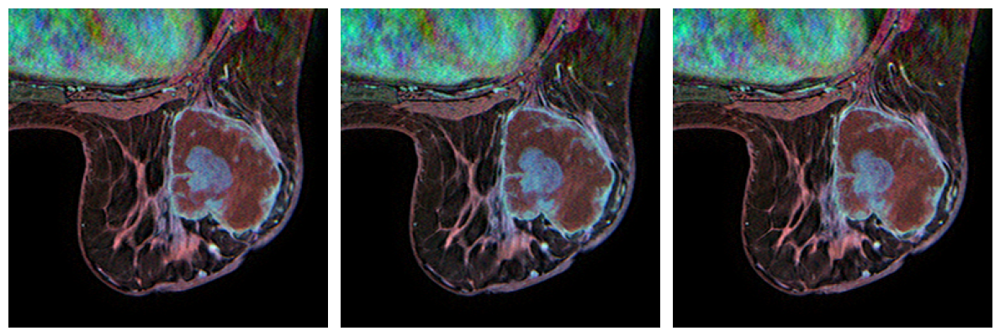

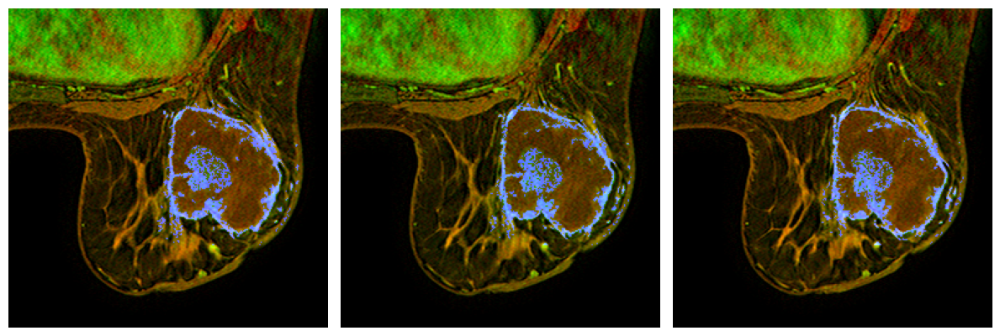

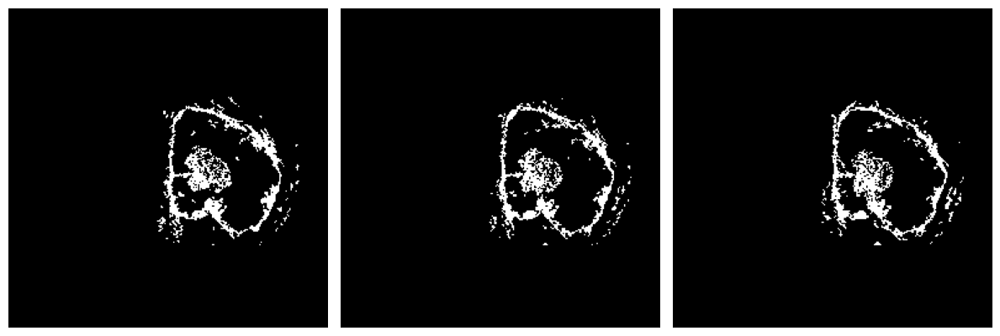

In [155]:
    pid='ISPY2-550421'
    
    row = df[df.pid==pid].iloc[0]
    smask=int(row['mask_start'])
    emask = int(row['mask_end'])
    pmask = (smask+emask)//2
    nz=int(row['n_z'])
    nxy=int(row['n_xy'])
    print('mask: ', smask,emask)
        
    d=get_all_nifti_acquisitions(pid)
    m = get_nifti_mask(pid)
    
    im=to_rgb(d[0],d[1], d[2]) 
    show_n_images([to_rgb(d[0][k],d[1][k], d[2][k]) for k in [pmask-1,pmask,pmask+1]])
    show_n_images([to_rgb(d[0][k],d[1][k], m[k]) for k in [pmask-1,pmask,pmask+1]])
    show_n_images([ m[k] for k in [pmask-1,pmask,pmask+1]])
    
    

    

In [156]:
len(d),d[0].shape,m.shape

(3, (70, 256, 256), (70, 256, 256))

## create sample jpg images for ISPY2

In [162]:
sample_dir = "spy2_min_crop_samples"
os.makedirs(sample_dir, exist_ok=True)

In [163]:
 for i,row in df[df.dataset=='spy2'].iterrows():
        
        
        pid = row['pid']
        print('===',pid)
        smask=int(row['mask_start'])
        emask = int(row['mask_end'])
        pmask = (smask+emask)//2
        nz=int(row['n_z'])
        nxy=int(row['n_xy'])
        nt = int(row['n_times'])
        
        
        b=get_all_nifti_acquisitions(pid)
        
        mb=get_nifti_mask(pid)
        
        df.at[i, 'n_z']=b[0].shape[0]
        nz = b[0].shape[0]
        
        assert(nxy==b[0].shape[1])
        
        assert(len(b)==3)
        for k in range(3):
            assert(b[k].shape==mb.shape)
            assert(nxy==b[k].shape[1])
            assert(nz==b[k].shape[0])

            
        p0 = int(row['pre'])
        p1 = int(row['post_early'])
        p2 = int(row['post_late'])
        
        imf = to_rgb(b[0][pmask],b[1][pmask],mb[pmask])
        imf = (imf*255).astype(np.uint8)
        
        mfname  = pid+'_min_crop_sample_'+str(pmask)+'.png'

            
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))
        print('saved ',mfname)


=== ACRIN-6698-102212
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-102212_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-102212_min_crop_sample_20.png
=== ACRIN-6698-103939
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-103939_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-103939_min_crop_sample_14.png
=== ACRIN-6698-104268
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-104268_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-104268_min_crop_sample_14.png
=== ACRIN-6698-107700
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-107700_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-107700_min_crop_sample_13.png
=== ACRIN-6698-108969
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-108969_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-108969_min_crop_sample_30.png
=== ACRIN-6698-115987
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-115987_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-115987_min_crop_sample_14.png
=== ACRIN-6698-116603
G:\My Drive\breast_mri\SPY2\vis1\cro

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-277888_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-277888_min_crop_sample_20.png
=== ACRIN-6698-280375
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-280375_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-280375_min_crop_sample_13.png
=== ACRIN-6698-283070
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-283070_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-283070_min_crop_sample_30.png
=== ACRIN-6698-284443
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-284443_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-284443_min_crop_sample_29.png
=== ACRIN-6698-284593
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-284593_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-284593_min_crop_sample_14.png
=== ACRIN-6698-285339
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-285339_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-285339_min_crop_sample_29.png
=== ACRIN-6698-287961
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-435279_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-435279_min_crop_sample_25.png
=== ACRIN-6698-460642
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-460642_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-460642_min_crop_sample_29.png
=== ACRIN-6698-462582
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-462582_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-462582_min_crop_sample_22.png
=== ACRIN-6698-465008
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-465008_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-465008_min_crop_sample_9.png
=== ACRIN-6698-467686
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-467686_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-467686_min_crop_sample_12.png
=== ACRIN-6698-474874
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-474874_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-474874_min_crop_sample_19.png
=== ACRIN-6698-490023
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-4

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-661730_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-661730_min_crop_sample_12.png
=== ACRIN-6698-663144
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-663144_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-663144_min_crop_sample_19.png
=== ACRIN-6698-664111
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-664111_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-664111_min_crop_sample_9.png
=== ACRIN-6698-677910
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-677910_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-677910_min_crop_sample_18.png
=== ACRIN-6698-680881
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-680881_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-680881_min_crop_sample_33.png
=== ACRIN-6698-683896
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-683896_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-683896_min_crop_sample_13.png
=== ACRIN-6698-685795
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-6

saved  ACRIN-6698-805136_min_crop_sample_25.png
=== ACRIN-6698-820807
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-820807_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-820807_min_crop_sample_23.png
=== ACRIN-6698-831848
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-831848_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-831848_min_crop_sample_12.png
=== ACRIN-6698-839274
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-839274_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-839274_min_crop_sample_38.png
=== ACRIN-6698-843554
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-843554_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-843554_min_crop_sample_15.png
=== ACRIN-6698-845783
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-845783_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-845783_min_crop_sample_10.png
=== ACRIN-6698-848003
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-848003_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-848003_min_crop_sample_10.png
=== ACRIN-

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ACRIN-6698-995480_spy2_vis1_mask.nii.gz
saved  ACRIN-6698-995480_min_crop_sample_13.png
=== ISPY2-100899
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-100899_spy2_vis1_mask.nii.gz
saved  ISPY2-100899_min_crop_sample_18.png
=== ISPY2-102011
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-102011_spy2_vis1_mask.nii.gz
saved  ISPY2-102011_min_crop_sample_11.png
=== ISPY2-103693
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-103693_spy2_vis1_mask.nii.gz
saved  ISPY2-103693_min_crop_sample_9.png
=== ISPY2-104384
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-104384_spy2_vis1_mask.nii.gz
saved  ISPY2-104384_min_crop_sample_16.png
=== ISPY2-105286
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-105286_spy2_vis1_mask.nii.gz
saved  ISPY2-105286_min_crop_sample_20.png
=== ISPY2-105513
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-105513_spy2_vis1_mask.nii.gz
saved  ISPY2-105513_min_crop_sample_19.png
=== ISPY2-1089

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-153880_spy2_vis1_mask.nii.gz
saved  ISPY2-153880_min_crop_sample_12.png
=== ISPY2-154293
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-154293_spy2_vis1_mask.nii.gz
saved  ISPY2-154293_min_crop_sample_23.png
=== ISPY2-155171
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-155171_spy2_vis1_mask.nii.gz
saved  ISPY2-155171_min_crop_sample_56.png
=== ISPY2-157270
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-157270_spy2_vis1_mask.nii.gz
saved  ISPY2-157270_min_crop_sample_36.png
=== ISPY2-157463
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-157463_spy2_vis1_mask.nii.gz
saved  ISPY2-157463_min_crop_sample_27.png
=== ISPY2-159284
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-159284_spy2_vis1_mask.nii.gz
saved  ISPY2-159284_min_crop_sample_29.png
=== ISPY2-159352
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-159352_spy2_vis1_mask.nii.gz
saved  ISPY2-159352_min_crop_sample_23.png
=== ISPY2-160120
G:\My 

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-227832_spy2_vis1_mask.nii.gz
saved  ISPY2-227832_min_crop_sample_37.png
=== ISPY2-227881
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-227881_spy2_vis1_mask.nii.gz
saved  ISPY2-227881_min_crop_sample_21.png
=== ISPY2-228192
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-228192_spy2_vis1_mask.nii.gz
saved  ISPY2-228192_min_crop_sample_24.png
=== ISPY2-228340
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-228340_spy2_vis1_mask.nii.gz
saved  ISPY2-228340_min_crop_sample_36.png
=== ISPY2-229144
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-229144_spy2_vis1_mask.nii.gz
saved  ISPY2-229144_min_crop_sample_14.png
=== ISPY2-229328
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-229328_spy2_vis1_mask.nii.gz
saved  ISPY2-229328_min_crop_sample_28.png
=== ISPY2-229824
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-229824_spy2_vis1_mask.nii.gz
saved  ISPY2-229824_min_crop_sample_50.png
=== ISPY2-231633
G:\My 

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-301289_spy2_vis1_mask.nii.gz
saved  ISPY2-301289_min_crop_sample_9.png
=== ISPY2-301968
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-301968_spy2_vis1_mask.nii.gz
saved  ISPY2-301968_min_crop_sample_18.png
=== ISPY2-303685
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-303685_spy2_vis1_mask.nii.gz
saved  ISPY2-303685_min_crop_sample_9.png
=== ISPY2-303947
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-303947_spy2_vis1_mask.nii.gz
saved  ISPY2-303947_min_crop_sample_17.png
=== ISPY2-306127
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-306127_spy2_vis1_mask.nii.gz
saved  ISPY2-306127_min_crop_sample_29.png
=== ISPY2-307659
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-307659_spy2_vis1_mask.nii.gz
saved  ISPY2-307659_min_crop_sample_20.png
=== ISPY2-309830
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-309830_spy2_vis1_mask.nii.gz
saved  ISPY2-309830_min_crop_sample_52.png
=== ISPY2-311316
G:\My Dr

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-375342_spy2_vis1_mask.nii.gz
saved  ISPY2-375342_min_crop_sample_21.png
=== ISPY2-375455
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-375455_spy2_vis1_mask.nii.gz
saved  ISPY2-375455_min_crop_sample_13.png
=== ISPY2-377460
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-377460_spy2_vis1_mask.nii.gz
saved  ISPY2-377460_min_crop_sample_24.png
=== ISPY2-378401
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-378401_spy2_vis1_mask.nii.gz
saved  ISPY2-378401_min_crop_sample_26.png
=== ISPY2-380239
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-380239_spy2_vis1_mask.nii.gz
saved  ISPY2-380239_min_crop_sample_9.png
=== ISPY2-380769
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-380769_spy2_vis1_mask.nii.gz
saved  ISPY2-380769_min_crop_sample_12.png
=== ISPY2-380972
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-380972_spy2_vis1_mask.nii.gz
saved  ISPY2-380972_min_crop_sample_11.png
=== ISPY2-382853
G:\My D

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-453596_spy2_vis1_mask.nii.gz
saved  ISPY2-453596_min_crop_sample_12.png
=== ISPY2-454808
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-454808_spy2_vis1_mask.nii.gz
saved  ISPY2-454808_min_crop_sample_8.png
=== ISPY2-455828
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-455828_spy2_vis1_mask.nii.gz
saved  ISPY2-455828_min_crop_sample_20.png
=== ISPY2-456432
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-456432_spy2_vis1_mask.nii.gz
saved  ISPY2-456432_min_crop_sample_23.png
=== ISPY2-456506
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-456506_spy2_vis1_mask.nii.gz
saved  ISPY2-456506_min_crop_sample_20.png
=== ISPY2-458196
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-458196_spy2_vis1_mask.nii.gz
saved  ISPY2-458196_min_crop_sample_14.png
=== ISPY2-459311
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-459311_spy2_vis1_mask.nii.gz
saved  ISPY2-459311_min_crop_sample_11.png
=== ISPY2-460776
G:\My D

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-515281_spy2_vis1_mask.nii.gz
saved  ISPY2-515281_min_crop_sample_19.png
=== ISPY2-515284
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-515284_spy2_vis1_mask.nii.gz
saved  ISPY2-515284_min_crop_sample_23.png
=== ISPY2-515565
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-515565_spy2_vis1_mask.nii.gz
saved  ISPY2-515565_min_crop_sample_22.png
=== ISPY2-517446
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-517446_spy2_vis1_mask.nii.gz
saved  ISPY2-517446_min_crop_sample_18.png
=== ISPY2-517870
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-517870_spy2_vis1_mask.nii.gz
saved  ISPY2-517870_min_crop_sample_15.png
=== ISPY2-518000
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-518000_spy2_vis1_mask.nii.gz
saved  ISPY2-518000_min_crop_sample_16.png
=== ISPY2-518576
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-518576_spy2_vis1_mask.nii.gz
saved  ISPY2-518576_min_crop_sample_12.png
=== ISPY2-519738
G:\My 

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-573881_spy2_vis1_mask.nii.gz
saved  ISPY2-573881_min_crop_sample_31.png
=== ISPY2-574091
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-574091_spy2_vis1_mask.nii.gz
saved  ISPY2-574091_min_crop_sample_7.png
=== ISPY2-575372
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-575372_spy2_vis1_mask.nii.gz
saved  ISPY2-575372_min_crop_sample_9.png
=== ISPY2-575457
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-575457_spy2_vis1_mask.nii.gz
saved  ISPY2-575457_min_crop_sample_16.png
=== ISPY2-578975
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-578975_spy2_vis1_mask.nii.gz
saved  ISPY2-578975_min_crop_sample_8.png
=== ISPY2-579881
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-579881_spy2_vis1_mask.nii.gz
saved  ISPY2-579881_min_crop_sample_13.png
=== ISPY2-581648
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-581648_spy2_vis1_mask.nii.gz
saved  ISPY2-581648_min_crop_sample_8.png
=== ISPY2-586091
G:\My Driv

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-637051_spy2_vis1_mask.nii.gz
saved  ISPY2-637051_min_crop_sample_10.png
=== ISPY2-637566
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-637566_spy2_vis1_mask.nii.gz
saved  ISPY2-637566_min_crop_sample_22.png
=== ISPY2-637752
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-637752_spy2_vis1_mask.nii.gz
saved  ISPY2-637752_min_crop_sample_34.png
=== ISPY2-639663
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-639663_spy2_vis1_mask.nii.gz
saved  ISPY2-639663_min_crop_sample_14.png
=== ISPY2-640043
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-640043_spy2_vis1_mask.nii.gz
saved  ISPY2-640043_min_crop_sample_16.png
=== ISPY2-640463
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-640463_spy2_vis1_mask.nii.gz
saved  ISPY2-640463_min_crop_sample_29.png
=== ISPY2-640927
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-640927_spy2_vis1_mask.nii.gz
saved  ISPY2-640927_min_crop_sample_27.png
=== ISPY2-644186
G:\My 

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-720065_spy2_vis1_mask.nii.gz
saved  ISPY2-720065_min_crop_sample_17.png
=== ISPY2-723918
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-723918_spy2_vis1_mask.nii.gz
saved  ISPY2-723918_min_crop_sample_26.png
=== ISPY2-725455
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-725455_spy2_vis1_mask.nii.gz
saved  ISPY2-725455_min_crop_sample_22.png
=== ISPY2-726091
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-726091_spy2_vis1_mask.nii.gz
saved  ISPY2-726091_min_crop_sample_16.png
=== ISPY2-726381
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-726381_spy2_vis1_mask.nii.gz
saved  ISPY2-726381_min_crop_sample_25.png
=== ISPY2-726940
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-726940_spy2_vis1_mask.nii.gz
saved  ISPY2-726940_min_crop_sample_21.png
=== ISPY2-727255
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-727255_spy2_vis1_mask.nii.gz
saved  ISPY2-727255_min_crop_sample_27.png
=== ISPY2-727804
G:\My 

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-797499_spy2_vis1_mask.nii.gz
saved  ISPY2-797499_min_crop_sample_8.png
=== ISPY2-797639
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-797639_spy2_vis1_mask.nii.gz
saved  ISPY2-797639_min_crop_sample_20.png
=== ISPY2-798604
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-798604_spy2_vis1_mask.nii.gz
saved  ISPY2-798604_min_crop_sample_13.png
=== ISPY2-800710
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-800710_spy2_vis1_mask.nii.gz
saved  ISPY2-800710_min_crop_sample_16.png
=== ISPY2-802105
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-802105_spy2_vis1_mask.nii.gz
saved  ISPY2-802105_min_crop_sample_23.png
=== ISPY2-802778
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-802778_spy2_vis1_mask.nii.gz
saved  ISPY2-802778_min_crop_sample_9.png
=== ISPY2-803514
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-803514_spy2_vis1_mask.nii.gz
saved  ISPY2-803514_min_crop_sample_37.png
=== ISPY2-803677
G:\My Dr

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-883886_spy2_vis1_mask.nii.gz
saved  ISPY2-883886_min_crop_sample_19.png
=== ISPY2-884266
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-884266_spy2_vis1_mask.nii.gz
saved  ISPY2-884266_min_crop_sample_21.png
=== ISPY2-885590
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-885590_spy2_vis1_mask.nii.gz
saved  ISPY2-885590_min_crop_sample_18.png
=== ISPY2-885871
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-885871_spy2_vis1_mask.nii.gz
saved  ISPY2-885871_min_crop_sample_14.png
=== ISPY2-889049
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-889049_spy2_vis1_mask.nii.gz
saved  ISPY2-889049_min_crop_sample_22.png
=== ISPY2-889225
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-889225_spy2_vis1_mask.nii.gz
saved  ISPY2-889225_min_crop_sample_23.png
=== ISPY2-889721
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-889721_spy2_vis1_mask.nii.gz
saved  ISPY2-889721_min_crop_sample_11.png
=== ISPY2-890414
G:\My 

G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-960963_spy2_vis1_mask.nii.gz
saved  ISPY2-960963_min_crop_sample_10.png
=== ISPY2-962472
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-962472_spy2_vis1_mask.nii.gz
saved  ISPY2-962472_min_crop_sample_21.png
=== ISPY2-962664
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-962664_spy2_vis1_mask.nii.gz
saved  ISPY2-962664_min_crop_sample_19.png
=== ISPY2-962827
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-962827_spy2_vis1_mask.nii.gz
saved  ISPY2-962827_min_crop_sample_27.png
=== ISPY2-965265
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-965265_spy2_vis1_mask.nii.gz
saved  ISPY2-965265_min_crop_sample_12.png
=== ISPY2-966016
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-966016_spy2_vis1_mask.nii.gz
saved  ISPY2-966016_min_crop_sample_12.png
=== ISPY2-972307
G:\My Drive\breast_mri\SPY2\vis1\crop_min_mask\ISPY2-972307_spy2_vis1_mask.nii.gz
saved  ISPY2-972307_min_crop_sample_25.png
=== ISPY2-974181
G:\My 

In [165]:
nz,b[0].shape,b[1].shape,b[2].shape

(22, (22, 256, 256), (22, 256, 256), (22, 256, 256))

In [166]:
df.to_csv('BreastDCEDL_metadata_min_crop.csv', index = False)

# I-SPY1 example

In [173]:
pid='ISPY1_1072'
df[df.pid==pid]

,pid,pCR,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,...,race_white,race_black,HR,HER2,HR_HER2_STATUS,TripleNeg,HER2pos,HRposHER2neg,dataset,test
978,ISPY1_1072,0.0,256.0,20.0,3.0,0.0,1.0,2.0,2.0625,0.78125,...,1.0,0.0,0.0,0.0,TripleNeg,1.0,0.0,0.0,spy1,0.0


spy1 G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min
['ISPY1_1219_spy1_vis1_dce_aqc_0.nii.gz', 'ISPY1_1219_spy1_vis1_dce_aqc_1.nii.gz', 'ISPY1_1219_spy1_vis1_dce_aqc_2.nii.gz', 'ISPY1_1177_spy1_vis1_dce_aqc_0.nii.gz', 'ISPY1_1177_spy1_vis1_dce_aqc_1.nii.gz', 'ISPY1_1177_spy1_vis1_dce_aqc_2.nii.gz', 'ISPY1_1196_spy1_vis1_dce_aqc_0.nii.gz'] ISPY1_1072
['ISPY1_1072_spy1_vis1_dce_aqc_0.nii.gz', 'ISPY1_1072_spy1_vis1_dce_aqc_1.nii.gz', 'ISPY1_1072_spy1_vis1_dce_aqc_2.nii.gz']
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1072_spy1_vis1_mask.nii.gz
(20, 256, 256) 3


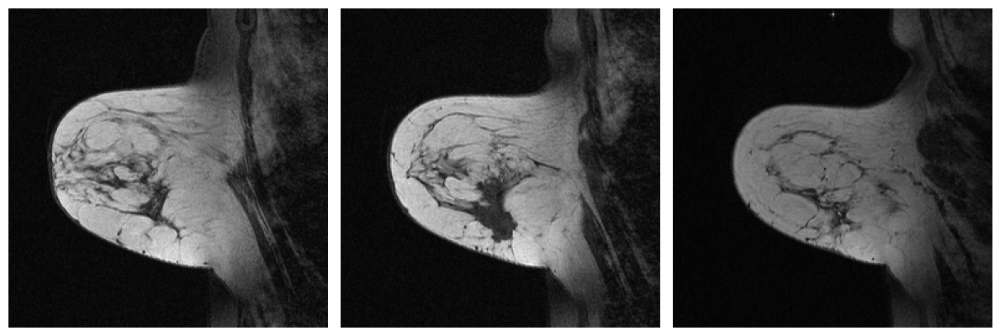

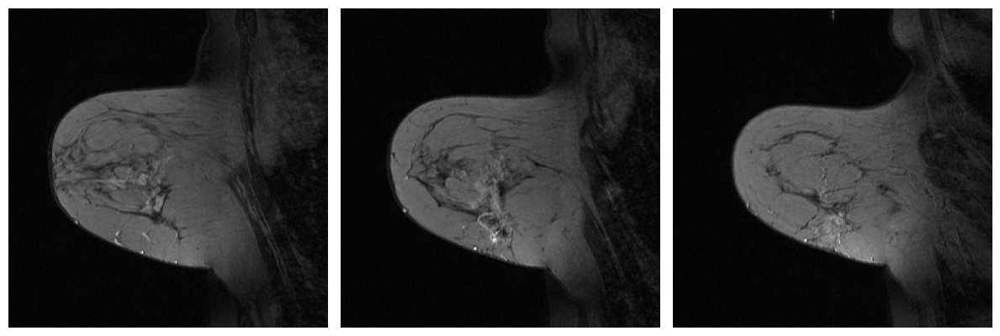

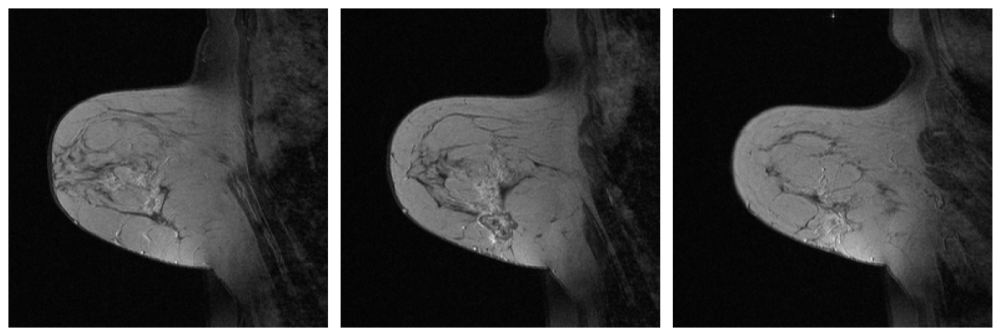

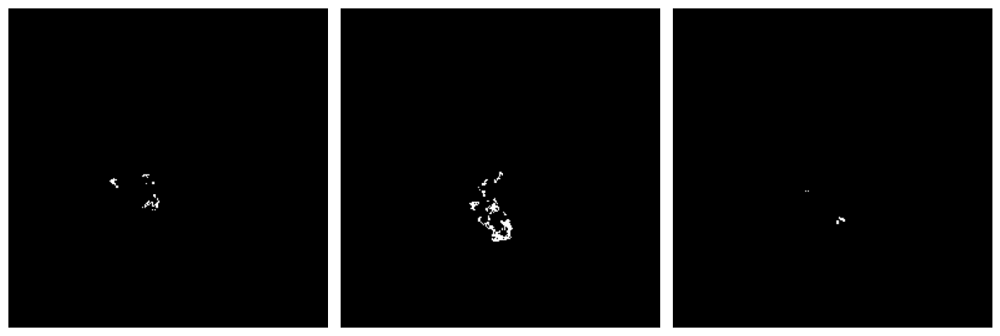

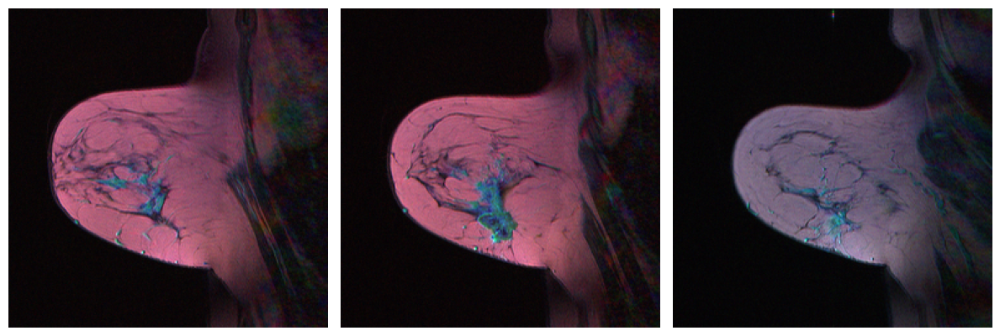

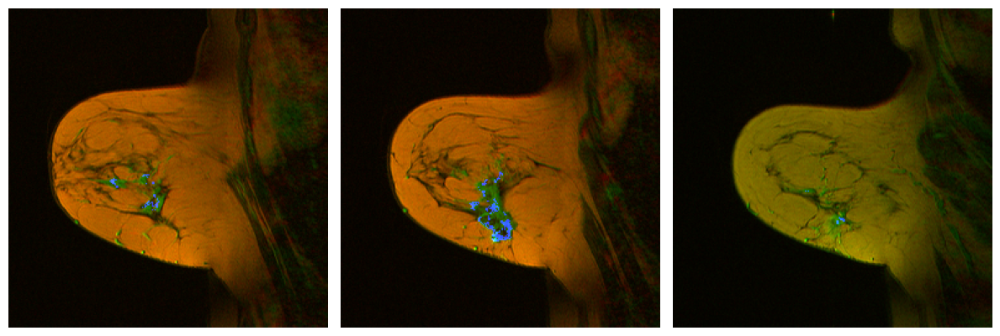

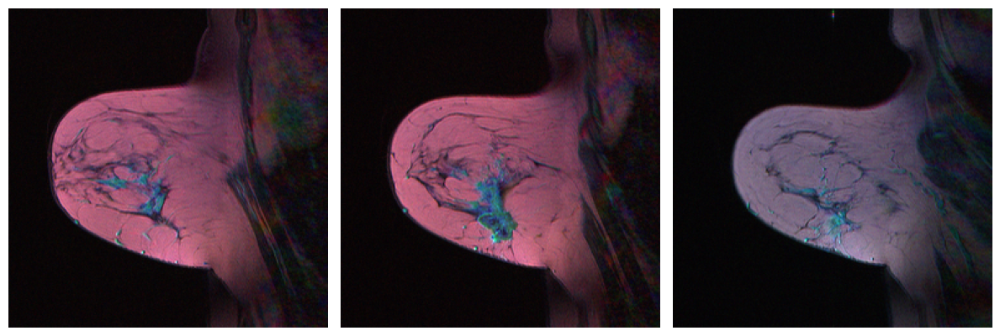

In [187]:
    deb=1
    d=get_sorted_nifti_acquisitions(pid)

    m=get_nifti_mask(pid)
    print(m.shape, len(d))
    idx=[5,10,15]
    show_n_images([d[0][k] for k in idx],axis_off=True)
    show_n_images([d[1][k] for k in idx],axis_off=True)
    show_n_images([d[2][k] for k in idx],axis_off=True)
    show_n_images([m[k] for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx],axis_off=True)
    show_n_images([to_rgb(d[0][k],
                                d[1][k],m[k]) for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx])


## create sample jpg images for ISPY1

In [189]:
sample_dir = "spy1_min_crop_samples"
os.makedirs(sample_dir, exist_ok=True)

In [192]:
deb=0

In [193]:
 for i,row in df[df.dataset=='spy1'].iterrows():
        
        
        pid = row['pid']
        print('===',pid)
        smask=int(row['mask_start'])
        emask = int(row['mask_end'])
        pmask = (smask+emask)//2
        nz=int(row['n_z'])
        nxy=int(row['n_xy'])
        nt = int(row['n_times'])
        
        
        b=get_sorted_nifti_acquisitions(pid)
        
        mb=get_nifti_mask(pid)
        
        
        nz = b[0].shape[0]
        
        assert(nxy==b[0].shape[1])
        
        assert(len(b)==3)
        for k in range(3):
            assert(b[k].shape==mb.shape)
            assert(nxy==b[k].shape[1])
            assert(nz==b[k].shape[0])

        df.at[i, 'n_z']=b[0].shape[0]
        
        
        
        imf = to_rgb(b[0][pmask],b[1][pmask],mb[pmask])
        imf = (imf*255).astype(np.uint8)
        
        mfname  = pid+'_min_crop_sample_'+str(pmask)+'.png'

            
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))
        print('saved ',mfname)


=== ISPY1_1219
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1219_spy1_vis1_mask.nii.gz
saved  ISPY1_1219_min_crop_sample_14.png
=== ISPY1_1177
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1177_spy1_vis1_mask.nii.gz
saved  ISPY1_1177_min_crop_sample_11.png
=== ISPY1_1196
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1196_spy1_vis1_mask.nii.gz
saved  ISPY1_1196_min_crop_sample_12.png
=== ISPY1_1227
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1227_spy1_vis1_mask.nii.gz
saved  ISPY1_1227_min_crop_sample_8.png
=== ISPY1_1036
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1036_spy1_vis1_mask.nii.gz
saved  ISPY1_1036_min_crop_sample_22.png
=== ISPY1_1054
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1054_spy1_vis1_mask.nii.gz
saved  ISPY1_1054_min_crop_sample_20.png
=== ISPY1_1140
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1140_spy1_vis1_mask.nii.gz
saved  ISPY1_1140_min_crop_sample_23.png
=== ISPY1_1011
G:\My Drive\b

G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1077_spy1_vis1_mask.nii.gz
saved  ISPY1_1077_min_crop_sample_11.png
=== ISPY1_1072
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1072_spy1_vis1_mask.nii.gz
saved  ISPY1_1072_min_crop_sample_9.png
=== ISPY1_1235
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1235_spy1_vis1_mask.nii.gz
saved  ISPY1_1235_min_crop_sample_9.png
=== ISPY1_1167
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1167_spy1_vis1_mask.nii.gz
saved  ISPY1_1167_min_crop_sample_35.png
=== ISPY1_1176
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1176_spy1_vis1_mask.nii.gz
saved  ISPY1_1176_min_crop_sample_11.png
=== ISPY1_1037
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1037_spy1_vis1_mask.nii.gz
saved  ISPY1_1037_min_crop_sample_14.png
=== ISPY1_1212
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1212_spy1_vis1_mask.nii.gz
saved  ISPY1_1212_min_crop_sample_11.png
=== ISPY1_1040
G:\My Drive\breast_mri\SPY1\v

saved  ISPY1_1171_min_crop_sample_15.png
=== ISPY1_1168
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1168_spy1_vis1_mask.nii.gz
saved  ISPY1_1168_min_crop_sample_8.png
=== ISPY1_1123
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1123_spy1_vis1_mask.nii.gz
saved  ISPY1_1123_min_crop_sample_16.png
=== ISPY1_1049
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1049_spy1_vis1_mask.nii.gz
saved  ISPY1_1049_min_crop_sample_25.png
=== ISPY1_1136
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1136_spy1_vis1_mask.nii.gz
saved  ISPY1_1136_min_crop_sample_12.png
=== ISPY1_1216
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1216_spy1_vis1_mask.nii.gz
saved  ISPY1_1216_min_crop_sample_5.png
=== ISPY1_1160
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1160_spy1_vis1_mask.nii.gz
saved  ISPY1_1160_min_crop_sample_12.png
=== ISPY1_1172
G:\My Drive\breast_mri\SPY1\vis1\v5_crop_min_mask\ISPY1_1172_spy1_vis1_mask.nii.gz
saved  ISPY1_1172_min_crop_sa

In [213]:
df.to_csv('BreastDCEDL_metadata_min_crop.csv', index = False)

### DUKE example

In [196]:
pid='Breast_MRI_001'
df[df.pid==pid]

,pid,pCR,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,...,race_white,race_black,HR,HER2,HR_HER2_STATUS,TripleNeg,HER2pos,HRposHER2neg,dataset,test
0,Breast_MRI_001,0.0,256.0,24.0,5.0,0.0,1.0,4.0,1.1,0.803571,...,0.0,1.0,0.0,1.0,HER2pos,0.0,1.0,0.0,duke,0.0


[  2  25 110 147 117 150]


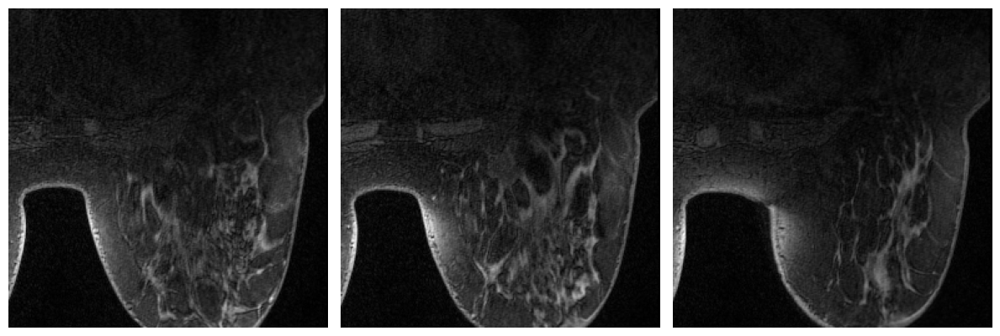

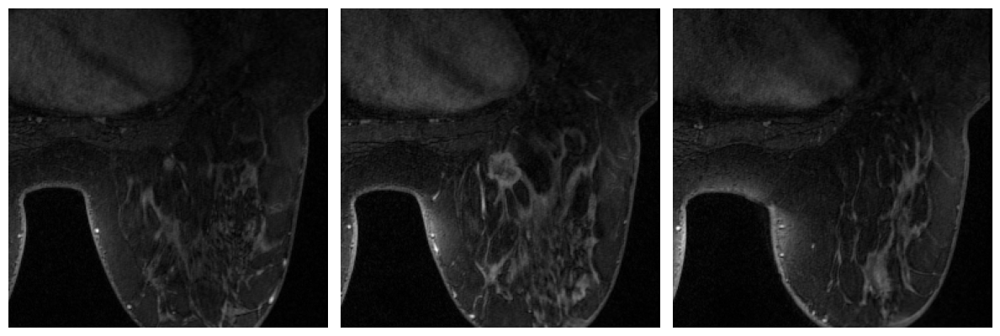

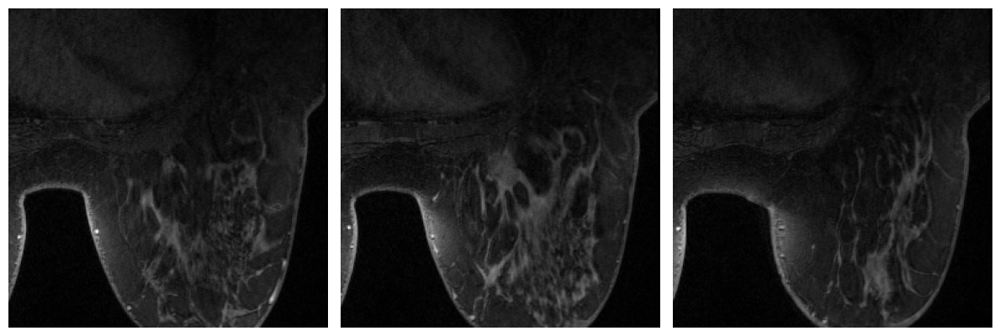

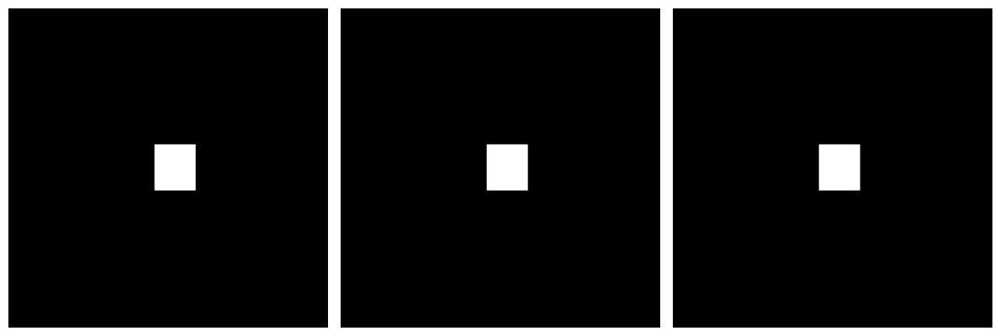

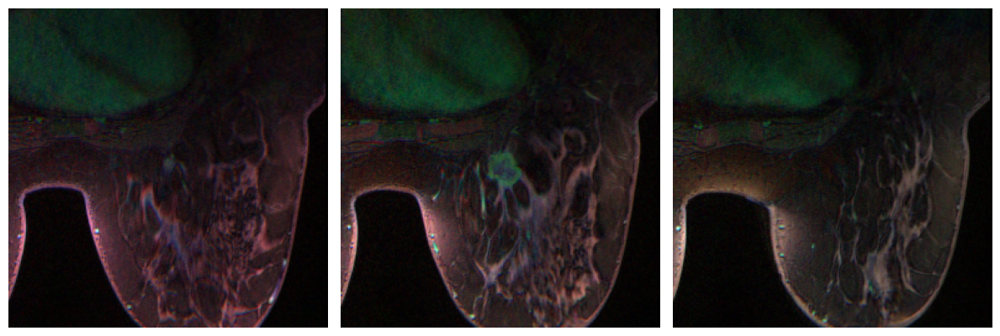

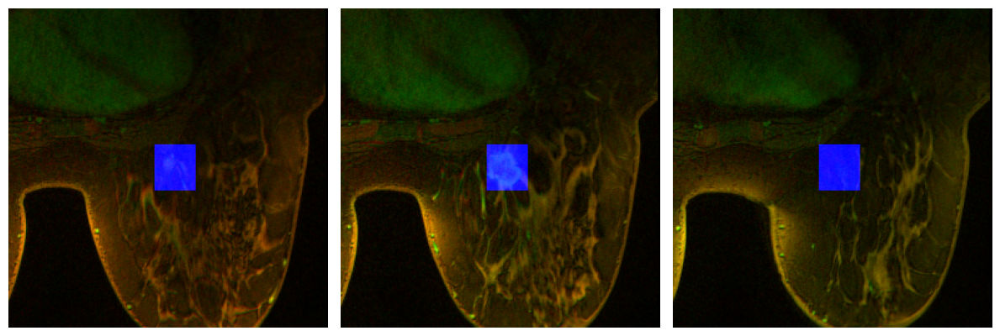

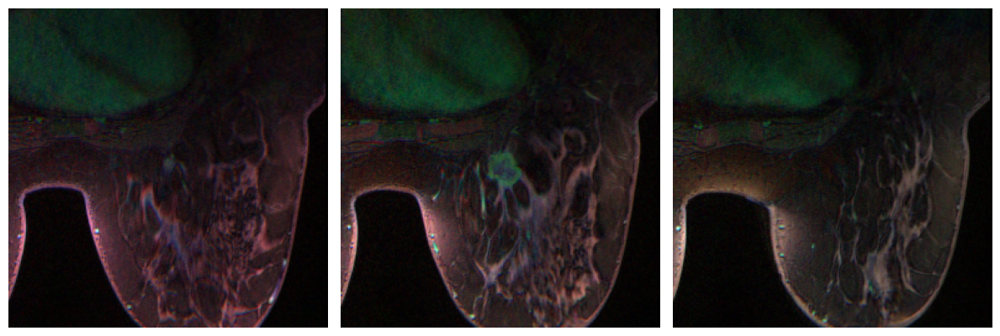

In [214]:
    
    bbox=df[df.pid==pid][['mask_start', 'mask_end',
           'sraw', 'eraw', 'scol', 'ecol']].values[0]
    print(bbox)
    d=get_sorted_nifti_acquisitions(pid)
    m=np.zeros(d[0].shape)
    m[bbox[0]:bbox[1], bbox[2]:bbox[3], bbox[4]:bbox[5]]=255
    idx=[bbox[0]+1,(bbox[0]+bbox[1])//2,bbox[1]-1]
    show_n_images([d[0][k] for k in idx],axis_off=True)
    show_n_images([d[1][k] for k in idx],axis_off=True)
    show_n_images([d[2][k] for k in idx],axis_off=True)
    show_n_images([m[k] for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx],axis_off=True)
    show_n_images([to_rgb(d[0][k],
                                d[1][k],m[k]) for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx])


In [222]:
pid='Breast_MRI_700'
df[df.pid==pid]

,pid,pCR,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,...,race_white,race_black,HR,HER2,HR_HER2_STATUS,TripleNeg,HER2pos,HRposHER2neg,dataset,test
695,Breast_MRI_700,NaN,256.0,28.0,3.0,0.0,1.0,2.0,2.0,0.758929,...,1.0,0.0,1.0,0.0,HRposHER2neg,0.0,0.0,1.0,duke,0.0


In [224]:
nifti_path['duke']

'G:\\My Drive\\breast_mri\\DUKE\\crop_min_dce'

[  2  29 107 150 119 147]


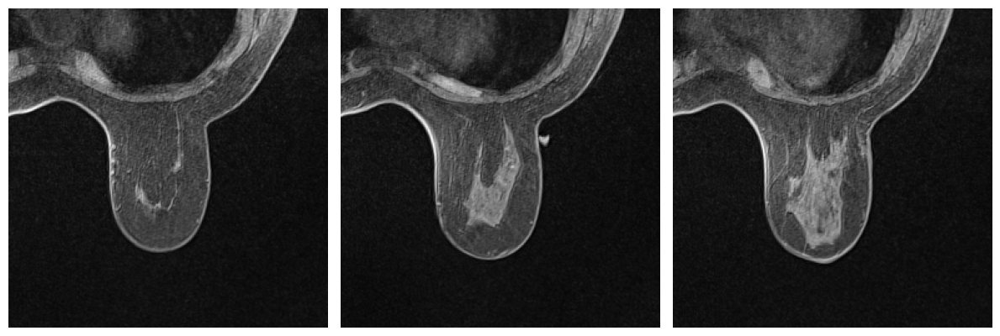

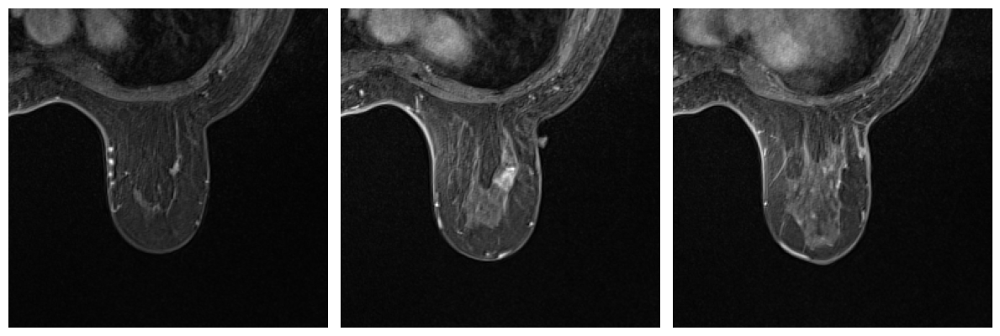

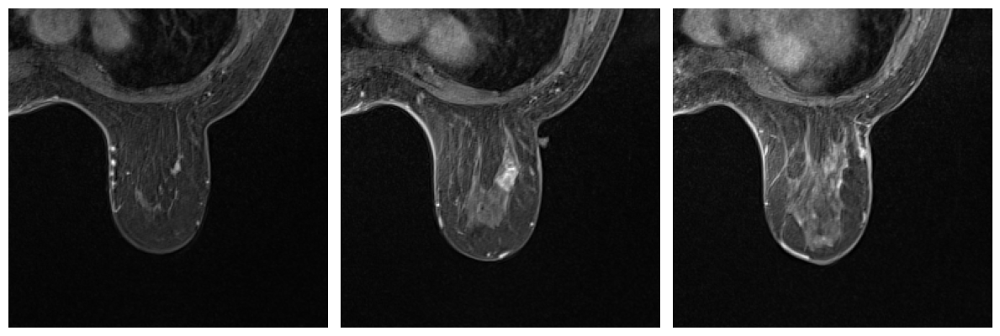

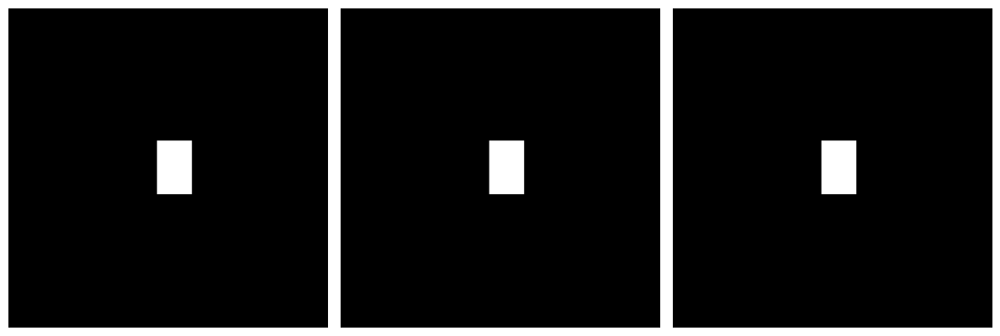

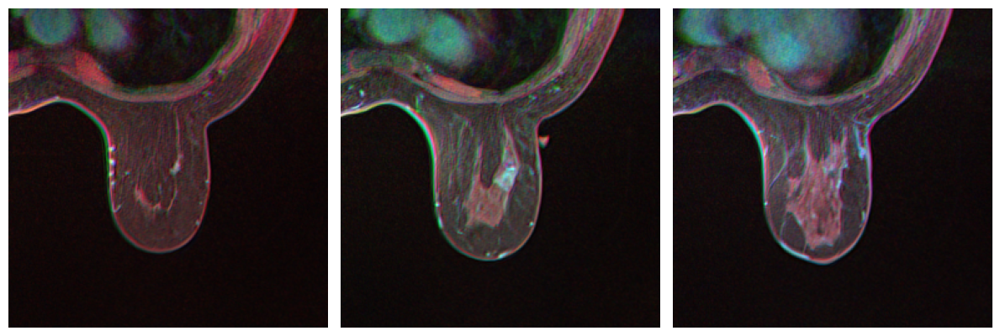

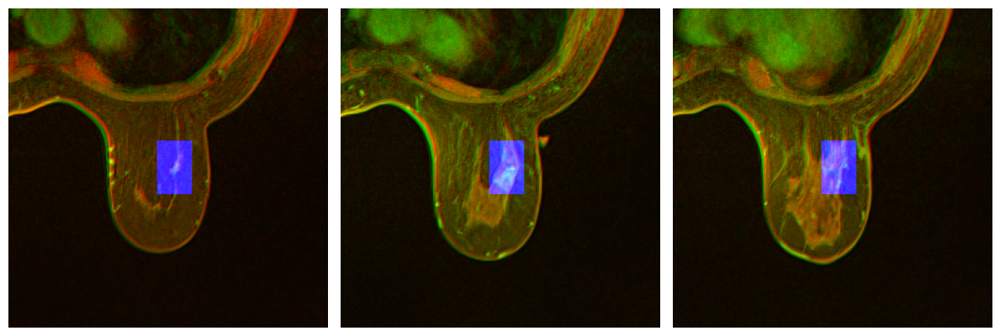

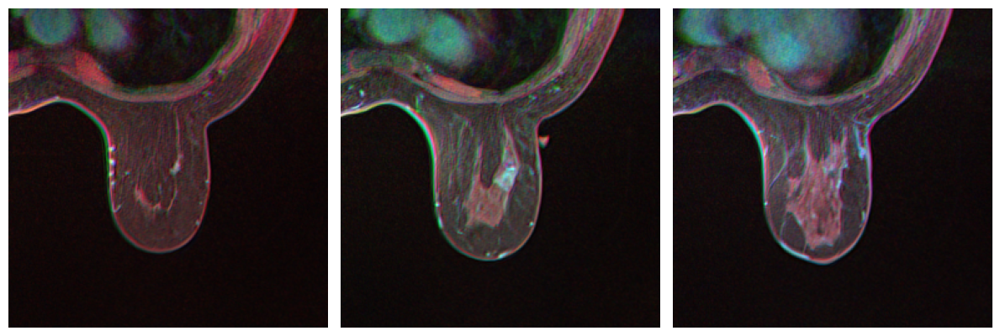

In [228]:
    
    bbox=df[df.pid==pid][['mask_start', 'mask_end',
           'sraw', 'eraw', 'scol', 'ecol']].values[0]
    print(bbox)
    d=get_all_nifti_acquisitions(pid, fpath='G:\\My Drive\\breast_mri\\DUKE\\min_dce')
    m=np.zeros(d[0].shape)
    m[bbox[0]:bbox[1], bbox[2]:bbox[3], bbox[4]:bbox[5]]=255
    idx=[bbox[0]+1,(bbox[0]+bbox[1])//2,bbox[1]-1]
    show_n_images([d[0][k] for k in idx],axis_off=True)
    show_n_images([d[1][k] for k in idx],axis_off=True)
    show_n_images([d[2][k] for k in idx],axis_off=True)
    show_n_images([m[k] for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx],axis_off=True)
    show_n_images([to_rgb(d[0][k],
                                d[1][k],m[k]) for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx])


## create sample jpg images for DUKE

In [217]:
sample_dir = "duke_min_crop_samples"
os.makedirs(sample_dir, exist_ok=True)

In [218]:
deb=0

In [ ]:
 for i,row in df[df.dataset=='duke'].iterrows():
        
        if i <690:
            continue
        pid = row['pid']
        print('===',pid)
        smask=int(row['mask_start'])
        emask = int(row['mask_end'])
        pmask = (smask+emask)//2
        nz=int(row['n_z'])
        nxy=int(row['n_xy'])
        nt = int(row['n_times'])
        
        
        b=get_sorted_nifti_acquisitions(pid)
        
        bbox=row[['mask_start', 'mask_end',
           'sraw', 'eraw', 'scol', 'ecol']]
        if deb: print(bbox)
        
        mb=np.zeros(b[0].shape)
        mb[bbox[0]:bbox[1], bbox[2]:bbox[3], bbox[4]:bbox[5]]=255
        
        
        nz = b[0].shape[0]
        
        assert(nxy==b[0].shape[1])
        
        assert(len(b)==3)
        for k in range(3):
            assert(b[k].shape==mb.shape)
            assert(nxy==b[k].shape[1])
            assert(nz==b[k].shape[0])

        df.at[i, 'n_z']=b[0].shape[0]
        
        imf = to_rgb(b[0][pmask],b[1][pmask],mb[pmask])
        imf = (imf*255).astype(np.uint8)
        
        mfname  = pid+'_min_crop_sample_'+str(pmask)+'.png'

            
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))
        print('saved ',mfname)


=== Breast_MRI_695
saved  Breast_MRI_695_min_crop_sample_20.png
=== Breast_MRI_696
saved  Breast_MRI_696_min_crop_sample_7.png
=== Breast_MRI_697
saved  Breast_MRI_697_min_crop_sample_8.png
=== Breast_MRI_698
saved  Breast_MRI_698_min_crop_sample_7.png
=== Breast_MRI_699
saved  Breast_MRI_699_min_crop_sample_7.png
=== Breast_MRI_700
saved  Breast_MRI_700_min_crop_sample_15.png
=== Breast_MRI_701
saved  Breast_MRI_701_min_crop_sample_29.png
=== Breast_MRI_702
saved  Breast_MRI_702_min_crop_sample_7.png
=== Breast_MRI_703
saved  Breast_MRI_703_min_crop_sample_30.png
=== Breast_MRI_704
saved  Breast_MRI_704_min_crop_sample_35.png
=== Breast_MRI_705
saved  Breast_MRI_705_min_crop_sample_12.png
=== Breast_MRI_706
saved  Breast_MRI_706_min_crop_sample_31.png
=== Breast_MRI_707
saved  Breast_MRI_707_min_crop_sample_9.png
=== Breast_MRI_708
saved  Breast_MRI_708_min_crop_sample_36.png
=== Breast_MRI_709
saved  Breast_MRI_709_min_crop_sample_9.png
=== Breast_MRI_710
saved  Breast_MRI_710_min_cr

In [ ]:
#BreastDCEDL_ISPY2_files_sizes

In [255]:
bpath='..\\PKG - BreastDCEDL_ISPY2\\BreastDCEDL_ISPY2\\'

In [239]:
pid='ISPY2-999733'
!mkdir tcia_sample
rdir='tcia_sample'

A subdirectory or file tcia_sample already exists.


In [240]:
df.columns

Index(['pid', 'pCR', 'n_xy', 'n_z', 'n_times', 'pre', 'post_early',
       'post_late', 'slice_thick', 'xy_spacing', 'mask_start', 'mask_end',
       'sraw', 'eraw', 'scol', 'ecol', 'tum_vol', 'age', 'menopause',
       'race_white', 'race_black', 'HR', 'HER2', 'HR_HER2_STATUS', 'TripleNeg',
       'HER2pos', 'HRposHER2neg', 'dataset', 'test'],
      dtype='object')

In [241]:
def get_max_plane(m):
    mi=-1
    ms=-1
    for i in range(m.shape[0]):
        if m[i].sum()>ms:
            ms=m[i].sum()
            mi=i
    return mi

In [244]:
os.path.join(bpath,pid,'mask')

'..\\PKG - BreastDCEDL_ISPY2\\BreastDCEDL_ISPY2\\ACRIN-6698-102212\\mask'

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-102212\mask\ACRIN-6698-102212_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-102212 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-102212\dce\ACRIN-6698-102212_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-102212\dce\ACRIN-6698-102212_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-102212\dce\ACRIN-6698-102212_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-102212\dce\ACRIN-6698-102212_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-102212\dce\ACRIN-6698-102212_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-102212\dce\ACRIN-6698-102212_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-102212\dce\ACRIN-6698

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-116603\dce\ACRIN-6698-116603_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-116603_26.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-118307\mask\ACRIN-6698-118307_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-118307 mask (72, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-118307\dce\ACRIN-6698-118307_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-118307\dce\ACRIN-6698-118307_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-118307\dce\ACRIN-6698-118307_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-118307\dce\ACRIN-6698-118307_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-118307\dce\ACRIN-6698-118307_spy2_vis1_dce_aqc_4.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-146987\dce\ACRIN-6698-146987_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-146987\dce\ACRIN-6698-146987_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-146987\dce\ACRIN-6698-146987_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-146987\dce\ACRIN-6698-146987_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-146987\dce\ACRIN-6698-146987_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-146987\dce\ACRIN-6698-146987_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-146987\dce\ACRIN-6698-146987_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-146987_32.png
..\PKG - BreastDCED

ACRIN-6698-169918 mask (160, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-169918\dce\ACRIN-6698-169918_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-169918\dce\ACRIN-6698-169918_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-169918\dce\ACRIN-6698-169918_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-169918\dce\ACRIN-6698-169918_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-169918\dce\ACRIN-6698-169918_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-169918\dce\ACRIN-6698-169918_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-169918\dce\ACRIN-6698-169918_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\AC

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-203060\dce\ACRIN-6698-203060_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-203060\dce\ACRIN-6698-203060_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-203060\dce\ACRIN-6698-203060_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-203060\dce\ACRIN-6698-203060_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-203060\dce\ACRIN-6698-203060_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ACRIN-6698-203060_48.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-208650\mask\ACRIN-6698-208650_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-208650 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-208650\dce\ACRIN-6698-208650_spy2_vis1_dce_aqc_0.nii

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-220925\dce\ACRIN-6698-220925_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-220925\dce\ACRIN-6698-220925_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-220925\dce\ACRIN-6698-220925_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-220925_45.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-221686\mask\ACRIN-6698-221686_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-221686 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-221686\dce\ACRIN-6698-221686_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-221686\dce\ACRIN-6698-221686_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-221686\dce\ACRIN-6698-221686_spy2_vis1_dce_aqc_2.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-239910\dce\ACRIN-6698-239910_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ACRIN-6698-239910_46.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-240957\mask\ACRIN-6698-240957_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-240957 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-240957\dce\ACRIN-6698-240957_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-240957\dce\ACRIN-6698-240957_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-240957\dce\ACRIN-6698-240957_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-240957\dce\ACRIN-6698-240957_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-240957\dce\ACRIN-6698-240957_spy2_vis1_dce_aqc_4.nii.

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-266840\dce\ACRIN-6698-266840_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-266840_44.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-269899\mask\ACRIN-6698-269899_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-269899 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-269899\dce\ACRIN-6698-269899_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-269899\dce\ACRIN-6698-269899_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-269899\dce\ACRIN-6698-269899_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-269899\dce\ACRIN-6698-269899_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-269899\dce\ACRIN-6698-269899_spy2_vis1_dce_aqc_4.nii.gz

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-284593\mask\ACRIN-6698-284593_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-284593 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-284593\dce\ACRIN-6698-284593_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-284593\dce\ACRIN-6698-284593_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-284593\dce\ACRIN-6698-284593_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-284593\dce\ACRIN-6698-284593_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-284593\dce\ACRIN-6698-284593_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-284593\dce\ACRIN-6698-284593_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-284593\dce\ACRIN-6698

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-296841\dce\ACRIN-6698-296841_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-296841\dce\ACRIN-6698-296841_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-296841\dce\ACRIN-6698-296841_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-296841\dce\ACRIN-6698-296841_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-296841\dce\ACRIN-6698-296841_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-296841_46.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-298101\mask\ACRIN-6698-298101_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-298101 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-298101\dce\ACRIN-6698-298101_spy2_vis1_dce_aqc_0.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-320538\dce\ACRIN-6698-320538_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-320538\dce\ACRIN-6698-320538_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-320538\dce\ACRIN-6698-320538_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-320538\dce\ACRIN-6698-320538_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-320538\dce\ACRIN-6698-320538_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-320538\dce\ACRIN-6698-320538_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ACRIN-6698-320538_23.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-323721\mask\ACRIN-6698-323721_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-323721 mask 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-343898\dce\ACRIN-6698-343898_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-343898\dce\ACRIN-6698-343898_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-343898\dce\ACRIN-6698-343898_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-343898\dce\ACRIN-6698-343898_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-343898\dce\ACRIN-6698-343898_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-343898\dce\ACRIN-6698-343898_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ACRIN-6698-343898_66.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-345907\mask\ACRIN-6698-345907_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-345907 ma

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-375954\dce\ACRIN-6698-375954_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-375954\dce\ACRIN-6698-375954_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-375954\dce\ACRIN-6698-375954_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-375954\dce\ACRIN-6698-375954_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-375954\dce\ACRIN-6698-375954_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ACRIN-6698-375954_71.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-376676\mask\ACRIN-6698-376676_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-376676 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-376676\dce\ACRIN-6698-376676_spy2_vis1_dce_aqc_0.nii.

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-399478\dce\ACRIN-6698-399478_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-399478\dce\ACRIN-6698-399478_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-399478\dce\ACRIN-6698-399478_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-399478\dce\ACRIN-6698-399478_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-399478\dce\ACRIN-6698-399478_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ACRIN-6698-399478_49.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-401215\mask\ACRIN-6698-401215_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-401215 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-401215\dce\ACRIN-6698-401215_spy2_vis1_dce_aqc_0.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-414844\dce\ACRIN-6698-414844_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-414844\dce\ACRIN-6698-414844_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-414844\dce\ACRIN-6698-414844_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-414844\dce\ACRIN-6698-414844_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-414844\dce\ACRIN-6698-414844_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-414844\dce\ACRIN-6698-414844_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(124, 256, 256) (124, 256, 256) (124, 256, 256)
saving: tcia_sample\ACRIN-6698-414844_86.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-417474\mask\ACRIN-6698-417474_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-417474 ma

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-435279\dce\ACRIN-6698-435279_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-435279\dce\ACRIN-6698-435279_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-435279\dce\ACRIN-6698-435279_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-435279\dce\ACRIN-6698-435279_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ACRIN-6698-435279_37.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-460642\mask\ACRIN-6698-460642_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-460642 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-460642\dce\ACRIN-6698-460642_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-460642\dce\ACRIN-6698-460642_spy2_vis1_dce_aqc_1.nii.gz

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-490805\dce\ACRIN-6698-490805_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-490805\dce\ACRIN-6698-490805_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-490805\dce\ACRIN-6698-490805_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ACRIN-6698-490805_42.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-506623\mask\ACRIN-6698-506623_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-506623 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-506623\dce\ACRIN-6698-506623_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-506623\dce\ACRIN-6698-506623_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-506623\dce\ACRIN-6698-506623_spy2_vis1_dce_aqc_2.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-524170\dce\ACRIN-6698-524170_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-524170\dce\ACRIN-6698-524170_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-524170\dce\ACRIN-6698-524170_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-524170_14.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-530095\mask\ACRIN-6698-530095_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-530095 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-530095\dce\ACRIN-6698-530095_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-530095\dce\ACRIN-6698-530095_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-530095\dce\ACRIN-6698-530095_spy2_vis1_dce_aqc_2.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-573605\dce\ACRIN-6698-573605_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-573605\dce\ACRIN-6698-573605_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-573605\dce\ACRIN-6698-573605_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-573605\dce\ACRIN-6698-573605_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-573605_33.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-573919\mask\ACRIN-6698-573919_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-573919 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-573919\dce\ACRIN-6698-573919_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-573919\dce\ACRIN-6698-573919_spy2_vis1_dce_aqc_1.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-591810\dce\ACRIN-6698-591810_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-591810\dce\ACRIN-6698-591810_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-591810\dce\ACRIN-6698-591810_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ACRIN-6698-591810_62.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-597907\mask\ACRIN-6698-597907_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-597907 mask (64, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-597907\dce\ACRIN-6698-597907_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-597907\dce\ACRIN-6698-597907_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-597907\dce\ACRIN-6698-597907_spy2_vis1_dce_aqc_2.nii.

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-628788\dce\ACRIN-6698-628788_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(158, 256, 256) (158, 256, 256) (158, 256, 256)
saving: tcia_sample\ACRIN-6698-628788_88.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-628823\mask\ACRIN-6698-628823_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-628823 mask (76, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-628823\dce\ACRIN-6698-628823_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-628823\dce\ACRIN-6698-628823_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-628823\dce\ACRIN-6698-628823_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-628823\dce\ACRIN-6698-628823_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-628823\dce\ACRIN-6698-628823_spy2_vis1_dce_aqc_4.nii.

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-641246\dce\ACRIN-6698-641246_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(176, 384, 384) (176, 384, 384) (176, 384, 384)
saving: tcia_sample\ACRIN-6698-641246_59.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-641697\mask\ACRIN-6698-641697_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-641697 mask (160, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-641697\dce\ACRIN-6698-641697_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-641697\dce\ACRIN-6698-641697_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-641697\dce\ACRIN-6698-641697_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-641697\dce\ACRIN-6698-641697_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-641697\dce\ACRIN-6698-641697_spy2_vis1_dce_aqc_4.nii

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-653927\dce\ACRIN-6698-653927_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-653927_35.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-654021\mask\ACRIN-6698-654021_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-654021 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-654021\dce\ACRIN-6698-654021_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-654021\dce\ACRIN-6698-654021_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-654021\dce\ACRIN-6698-654021_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-654021\dce\ACRIN-6698-654021_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-654021\dce\ACRIN-6698-654021_spy2_vis1_dce_aqc_4.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-677910\dce\ACRIN-6698-677910_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 320, 320) (80, 320, 320) (80, 320, 320)
saving: tcia_sample\ACRIN-6698-677910_26.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-680881\mask\ACRIN-6698-680881_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-680881 mask (80, 312, 312)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-680881\dce\ACRIN-6698-680881_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-680881\dce\ACRIN-6698-680881_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-680881\dce\ACRIN-6698-680881_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-680881\dce\ACRIN-6698-680881_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-680881\dce\ACRIN-6698-680881_spy2_vis1_dce_aqc_4.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-689452\dce\ACRIN-6698-689452_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-689452\dce\ACRIN-6698-689452_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-689452\dce\ACRIN-6698-689452_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-689452\dce\ACRIN-6698-689452_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-689452\dce\ACRIN-6698-689452_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-689452\dce\ACRIN-6698-689452_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(64, 256, 256) (64, 256, 256) (64, 256, 256)
saving: tcia_sample\ACRIN-6698-689452_25.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-689480\mask\ACRIN-6698-689480_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-689480 mask 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-706639\dce\ACRIN-6698-706639_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-706639\dce\ACRIN-6698-706639_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-706639\dce\ACRIN-6698-706639_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-706639\dce\ACRIN-6698-706639_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-706639\dce\ACRIN-6698-706639_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-706639\dce\ACRIN-6698-706639_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-706639\dce\ACRIN-6698-706639_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(76, 256, 256) (76, 256, 256) (76, 256, 256)
saving: tcia_sample\ACRIN-6698-706639_56.png
..\PKG - BreastDCED

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-728182\dce\ACRIN-6698-728182_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-728182\dce\ACRIN-6698-728182_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-728182\dce\ACRIN-6698-728182_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(150, 384, 384) (150, 384, 384) (150, 384, 384)
saving: tcia_sample\ACRIN-6698-728182_83.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-734997\mask\ACRIN-6698-734997_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-734997 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-734997\dce\ACRIN-6698-734997_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-734997\dce\ACRIN-6698-734997_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-734997\dce\ACRIN-6698-734997_spy2_vis1_dce_aqc_2.nii

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-755914\dce\ACRIN-6698-755914_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-755914\dce\ACRIN-6698-755914_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-755914\dce\ACRIN-6698-755914_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ACRIN-6698-755914_78.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-760011\mask\ACRIN-6698-760011_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-760011 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-760011\dce\ACRIN-6698-760011_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-760011\dce\ACRIN-6698-760011_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-760011\dce\ACRIN-6698-760011_spy2_vis1_dce_aqc_2.nii.

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-775346\dce\ACRIN-6698-775346_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-775346\dce\ACRIN-6698-775346_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-775346\dce\ACRIN-6698-775346_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-775346\dce\ACRIN-6698-775346_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-775346\dce\ACRIN-6698-775346_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-775346\dce\ACRIN-6698-775346_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-775346_48.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-779739\mask\ACRIN-6698-779739_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-779739 mask 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-795996\dce\ACRIN-6698-795996_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-795996\dce\ACRIN-6698-795996_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-795996\dce\ACRIN-6698-795996_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-795996\dce\ACRIN-6698-795996_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ACRIN-6698-795996_65.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-799149\mask\ACRIN-6698-799149_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-799149 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-799149\dce\ACRIN-6698-799149_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-799149\dce\ACRIN-6698-799149_spy2_vis1_dce_aqc_1.nii.

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-820807\dce\ACRIN-6698-820807_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-820807_37.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-831848\mask\ACRIN-6698-831848_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-831848 mask (72, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-831848\dce\ACRIN-6698-831848_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-831848\dce\ACRIN-6698-831848_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-831848\dce\ACRIN-6698-831848_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-831848\dce\ACRIN-6698-831848_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-831848\dce\ACRIN-6698-831848_spy2_vis1_dce_aqc_4.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-860243\dce\ACRIN-6698-860243_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ACRIN-6698-860243_38.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-860901\mask\ACRIN-6698-860901_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-860901 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-860901\dce\ACRIN-6698-860901_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-860901\dce\ACRIN-6698-860901_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-860901\dce\ACRIN-6698-860901_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-860901\dce\ACRIN-6698-860901_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-860901\dce\ACRIN-6698-860901_spy2_vis1_dce_aqc_4.nii.gz

0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ACRIN-6698-879224_88.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-882553\mask\ACRIN-6698-882553_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-882553 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-882553\dce\ACRIN-6698-882553_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-882553\dce\ACRIN-6698-882553_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-882553\dce\ACRIN-6698-882553_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-882553\dce\ACRIN-6698-882553_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-882553\dce\ACRIN-6698-882553_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-882553\dce\ACRIN-6698-882553_spy2_vis1_dce_aqc_5.nii.

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-896852\dce\ACRIN-6698-896852_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(90, 312, 312) (90, 312, 312) (90, 312, 312)
saving: tcia_sample\ACRIN-6698-896852_26.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-899692\mask\ACRIN-6698-899692_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-899692 mask (72, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-899692\dce\ACRIN-6698-899692_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-899692\dce\ACRIN-6698-899692_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-899692\dce\ACRIN-6698-899692_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-899692\dce\ACRIN-6698-899692_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-899692\dce\ACRIN-6698-899692_spy2_vis1_dce_aqc_4.nii.gz 

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-928815\dce\ACRIN-6698-928815_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-928815\dce\ACRIN-6698-928815_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-928815\dce\ACRIN-6698-928815_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-928815\dce\ACRIN-6698-928815_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-928815\dce\ACRIN-6698-928815_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-928815\dce\ACRIN-6698-928815_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-928815\dce\ACRIN-6698-928815_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-928815_64.png
..\PKG - BreastDCED

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-947398\dce\ACRIN-6698-947398_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-947398\dce\ACRIN-6698-947398_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-947398\dce\ACRIN-6698-947398_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-947398\dce\ACRIN-6698-947398_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-947398\dce\ACRIN-6698-947398_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-947398\dce\ACRIN-6698-947398_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-947398\dce\ACRIN-6698-947398_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ACRIN-6698-947398_24.png
..\PKG - BreastDCED

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-963604\dce\ACRIN-6698-963604_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-963604\dce\ACRIN-6698-963604_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-963604\dce\ACRIN-6698-963604_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-963604\dce\ACRIN-6698-963604_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-963604\dce\ACRIN-6698-963604_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-963604\dce\ACRIN-6698-963604_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ACRIN-6698-963604_48.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-970839\mask\ACRIN-6698-970839_spy2_vis1_mask.nii.gz  is_file  True
ACRIN-6698-970839 mask 

ACRIN-6698-991818 mask (90, 320, 320)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-991818\dce\ACRIN-6698-991818_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-991818\dce\ACRIN-6698-991818_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-991818\dce\ACRIN-6698-991818_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-991818\dce\ACRIN-6698-991818_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-991818\dce\ACRIN-6698-991818_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-991818\dce\ACRIN-6698-991818_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ACRIN-6698-991818\dce\ACRIN-6698-991818_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(90, 320, 320) (90, 320, 320) (90, 320, 320)
saving: tcia_sample\ACRIN-

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-105286\dce\ISPY2-105286_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-105286\dce\ISPY2-105286_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-105286\dce\ISPY2-105286_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-105286\dce\ISPY2-105286_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-105286\dce\ISPY2-105286_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(176, 384, 384) (176, 384, 384) (176, 384, 384)
saving: tcia_sample\ISPY2-105286_58.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-105513\mask\ISPY2-105513_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-105513 mask (160, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-105513\dce\ISPY2-105513_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-105513\dce

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-111038\dce\ISPY2-111038_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(64, 256, 256) (64, 256, 256) (64, 256, 256)
saving: tcia_sample\ISPY2-111038_38.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-111344\mask\ISPY2-111344_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-111344 mask (180, 320, 320)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-111344\dce\ISPY2-111344_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-111344\dce\ISPY2-111344_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-111344\dce\ISPY2-111344_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-111344\dce\ISPY2-111344_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-111344\dce\ISPY2-111344_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-111344\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-116165\dce\ISPY2-116165_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-116165\dce\ISPY2-116165_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-116165\dce\ISPY2-116165_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-116165\dce\ISPY2-116165_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ISPY2-116165_38.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-117424\mask\ISPY2-117424_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-117424 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-117424\dce\ISPY2-117424_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-117424\dce\ISPY2-117424_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-117424\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-122795\dce\ISPY2-122795_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-122795\dce\ISPY2-122795_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-122795\dce\ISPY2-122795_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-122795\dce\ISPY2-122795_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-122795\dce\ISPY2-122795_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-122795_31.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-123660\mask\ISPY2-123660_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-123660 mask (160, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-123660\dce\ISPY2-123660_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-123660\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-129837\dce\ISPY2-129837_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-129837\dce\ISPY2-129837_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-129837\dce\ISPY2-129837_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-129837\dce\ISPY2-129837_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-129837\dce\ISPY2-129837_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ISPY2-129837_63.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-129973\mask\ISPY2-129973_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-129973 mask (64, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-129973\dce\ISPY2-129973_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-129973\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-138425\dce\ISPY2-138425_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-138425\dce\ISPY2-138425_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-138425\dce\ISPY2-138425_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-138425\dce\ISPY2-138425_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-138425\dce\ISPY2-138425_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-138425\dce\ISPY2-138425_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-138425\dce\ISPY2-138425_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-138425\dce\ISPY2-138425_spy2_vis1_dce_aqc_8.nii.gz  is_file  True
0
(64, 256, 256) (64, 256, 256) (64, 256, 256)
saving: tcia_samp

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-147139\dce\ISPY2-147139_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-147139\dce\ISPY2-147139_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ISPY2-147139_41.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-149654\mask\ISPY2-149654_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-149654 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-149654\dce\ISPY2-149654_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-149654\dce\ISPY2-149654_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-149654\dce\ISPY2-149654_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-149654\dce\ISPY2-149654_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-149654\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-154293\dce\ISPY2-154293_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-154293\dce\ISPY2-154293_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-154293\dce\ISPY2-154293_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-154293\dce\ISPY2-154293_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-154293\dce\ISPY2-154293_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-154293\dce\ISPY2-154293_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-154293_49.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-155171\mask\ISPY2-155171_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-155171 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-155171\dce\IS

saving: tcia_sample\ISPY2-164468_37.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-166412\mask\ISPY2-166412_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-166412 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-166412\dce\ISPY2-166412_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-166412\dce\ISPY2-166412_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-166412\dce\ISPY2-166412_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-166412\dce\ISPY2-166412_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-166412\dce\ISPY2-166412_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-166412\dce\ISPY2-166412_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ISPY2-166412_76.png
..\PKG - BreastDCEDL_

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-174903\dce\ISPY2-174903_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-174903\dce\ISPY2-174903_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-174903\dce\ISPY2-174903_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-174903_41.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-174904\mask\ISPY2-174904_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-174904 mask (160, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-174904\dce\ISPY2-174904_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-174904\dce\ISPY2-174904_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-174904\dce\ISPY2-174904_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-174904\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-181819\dce\ISPY2-181819_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-181819\dce\ISPY2-181819_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-181819\dce\ISPY2-181819_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ISPY2-181819_28.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-182346\mask\ISPY2-182346_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-182346 mask (144, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-182346\dce\ISPY2-182346_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-182346\dce\ISPY2-182346_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-182346\dce\ISPY2-182346_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-182346\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-196024\dce\ISPY2-196024_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-196024\dce\ISPY2-196024_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-196024\dce\ISPY2-196024_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-196024\dce\ISPY2-196024_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ISPY2-196024_46.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-197942\mask\ISPY2-197942_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-197942 mask (72, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-197942\dce\ISPY2-197942_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-197942\dce\ISPY2-197942_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-197942\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-202539\dce\ISPY2-202539_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-202539\dce\ISPY2-202539_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ISPY2-202539_83.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-202956\mask\ISPY2-202956_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-202956 mask (66, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-202956\dce\ISPY2-202956_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-202956\dce\ISPY2-202956_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-202956\dce\ISPY2-202956_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-202956\dce\ISPY2-202956_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-202956\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-212307\dce\ISPY2-212307_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 384, 384) (160, 384, 384) (160, 384, 384)
saving: tcia_sample\ISPY2-212307_76.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-213328\mask\ISPY2-213328_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-213328 mask (80, 312, 312)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-213328\dce\ISPY2-213328_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-213328\dce\ISPY2-213328_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-213328\dce\ISPY2-213328_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-213328\dce\ISPY2-213328_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-213328\dce\ISPY2-213328_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-213328\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-223526\dce\ISPY2-223526_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-223526\dce\ISPY2-223526_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-223526\dce\ISPY2-223526_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-223526\dce\ISPY2-223526_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-223526\dce\ISPY2-223526_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-223526_53.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-225836\mask\ISPY2-225836_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-225836 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-225836\dce\ISPY2-225836_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-225836\dce\ISP

0
(90, 320, 320) (90, 320, 320) (90, 320, 320)
saving: tcia_sample\ISPY2-229328_61.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-229824\mask\ISPY2-229824_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-229824 mask (160, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-229824\dce\ISPY2-229824_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-229824\dce\ISPY2-229824_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-229824\dce\ISPY2-229824_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-229824\dce\ISPY2-229824_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-229824\dce\ISPY2-229824_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-229824\dce\ISPY2-229824_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(160, 384, 384) (160, 384, 384) (160, 384, 384)
saving: tcia_s

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-238790\dce\ISPY2-238790_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-238790\dce\ISPY2-238790_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-238790\dce\ISPY2-238790_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-238790\dce\ISPY2-238790_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-238790_41.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-239061\mask\ISPY2-239061_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-239061 mask (200, 448, 448)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-239061\dce\ISPY2-239061_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-239061\dce\ISPY2-239061_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-239061\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-246134\dce\ISPY2-246134_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-246134\dce\ISPY2-246134_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-246134\dce\ISPY2-246134_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-246134\dce\ISPY2-246134_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-246134\dce\ISPY2-246134_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ISPY2-246134_71.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-247641\mask\ISPY2-247641_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-247641 mask (66, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-247641\dce\ISPY2-247641_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-247641\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-255535\dce\ISPY2-255535_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-255535\dce\ISPY2-255535_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-255535\dce\ISPY2-255535_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(66, 256, 256) (66, 256, 256) (66, 256, 256)
saving: tcia_sample\ISPY2-255535_48.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-255577\mask\ISPY2-255577_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-255577 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-255577\dce\ISPY2-255577_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-255577\dce\ISPY2-255577_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-255577\dce\ISPY2-255577_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-255577\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-266509\dce\ISPY2-266509_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-266509\dce\ISPY2-266509_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-266509\dce\ISPY2-266509_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-266509\dce\ISPY2-266509_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-266509\dce\ISPY2-266509_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-266509\dce\ISPY2-266509_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ISPY2-266509_56.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-267306\mask\ISPY2-267306_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-267306 mask (200, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-267306\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-282082\dce\ISPY2-282082_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ISPY2-282082_72.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-282644\mask\ISPY2-282644_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-282644 mask (72, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-282644\dce\ISPY2-282644_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-282644\dce\ISPY2-282644_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-282644\dce\ISPY2-282644_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-282644\dce\ISPY2-282644_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-282644\dce\ISPY2-282644_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-282644\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-291515\dce\ISPY2-291515_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-291515\dce\ISPY2-291515_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-291515\dce\ISPY2-291515_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-291515\dce\ISPY2-291515_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-291515\dce\ISPY2-291515_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-291515\dce\ISPY2-291515_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-291515\dce\ISPY2-291515_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-291515_40.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-294176\mask\ISPY2-294176_spy2_vis1_mask.nii

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-301968\dce\ISPY2-301968_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(150, 320, 320) (150, 320, 320) (150, 320, 320)
saving: tcia_sample\ISPY2-301968_56.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-303685\mask\ISPY2-303685_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-303685 mask (124, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-303685\dce\ISPY2-303685_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-303685\dce\ISPY2-303685_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-303685\dce\ISPY2-303685_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-303685\dce\ISPY2-303685_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-303685\dce\ISPY2-303685_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-303685\dce

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-313243\dce\ISPY2-313243_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-313243\dce\ISPY2-313243_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-313243\dce\ISPY2-313243_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(64, 256, 256) (64, 256, 256) (64, 256, 256)
saving: tcia_sample\ISPY2-313243_39.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-313672\mask\ISPY2-313672_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-313672 mask (66, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-313672\dce\ISPY2-313672_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-313672\dce\ISPY2-313672_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-313672\dce\ISPY2-313672_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-313672\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-319324\dce\ISPY2-319324_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-319324\dce\ISPY2-319324_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-319324\dce\ISPY2-319324_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-319324\dce\ISPY2-319324_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-319324\dce\ISPY2-319324_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(66, 256, 256) (66, 256, 256) (66, 256, 256)
saving: tcia_sample\ISPY2-319324_42.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-324021\mask\ISPY2-324021_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-324021 mask (64, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-324021\dce\ISPY2-324021_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-324021\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-331192\dce\ISPY2-331192_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-331192\dce\ISPY2-331192_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-331192\dce\ISPY2-331192_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-331192\dce\ISPY2-331192_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-331192\dce\ISPY2-331192_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-331192\dce\ISPY2-331192_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ISPY2-331192_59.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-332655\mask\ISPY2-332655_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-332655 mask (72, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-332655\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-342996\dce\ISPY2-342996_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-342996_54.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-345460\mask\ISPY2-345460_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-345460 mask (180, 320, 320)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-345460\dce\ISPY2-345460_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-345460\dce\ISPY2-345460_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-345460\dce\ISPY2-345460_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-345460\dce\ISPY2-345460_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-345460\dce\ISPY2-345460_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-345460\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-349639\dce\ISPY2-349639_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-349639\dce\ISPY2-349639_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-349639\dce\ISPY2-349639_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-349639\dce\ISPY2-349639_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-349639\dce\ISPY2-349639_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-349639\dce\ISPY2-349639_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-349639\dce\ISPY2-349639_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(200, 384, 384) (200, 384, 384) (200, 384, 384)
saving: tcia_sample\ISPY2-349639_81.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-350331\mask\ISPY2-350331_spy2_vis1_mask.

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-360937\dce\ISPY2-360937_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-360937\dce\ISPY2-360937_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-360937\dce\ISPY2-360937_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-360937\dce\ISPY2-360937_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-360937\dce\ISPY2-360937_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-360937\dce\ISPY2-360937_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-360937\dce\ISPY2-360937_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-360937_30.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-362993\mask\ISPY2-362993_spy2_vis1_mask.nii

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-373672\dce\ISPY2-373672_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-373672\dce\ISPY2-373672_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ISPY2-373672_91.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-374106\mask\ISPY2-374106_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-374106 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-374106\dce\ISPY2-374106_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-374106\dce\ISPY2-374106_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-374106\dce\ISPY2-374106_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-374106\dce\ISPY2-374106_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-374106\dce

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-380769\dce\ISPY2-380769_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-380769\dce\ISPY2-380769_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-380769\dce\ISPY2-380769_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-380769\dce\ISPY2-380769_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-380769\dce\ISPY2-380769_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-380769\dce\ISPY2-380769_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-380769\dce\ISPY2-380769_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-380769_58.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-380972\mask\ISPY2-380972_spy2_vis1_mask.nii

ISPY2-395379 mask (200, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-395379\dce\ISPY2-395379_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-395379\dce\ISPY2-395379_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-395379\dce\ISPY2-395379_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-395379\dce\ISPY2-395379_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-395379\dce\ISPY2-395379_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
0
(200, 256, 256) (200, 256, 256) (200, 256, 256)
saving: tcia_sample\ISPY2-395379_123.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-402265\mask\ISPY2-402265_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-402265 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-402265\dce\ISPY2-402265_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-411806\dce\ISPY2-411806_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-411806\dce\ISPY2-411806_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-411806\dce\ISPY2-411806_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-411806\dce\ISPY2-411806_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(176, 384, 384) (176, 384, 384) (176, 384, 384)
saving: tcia_sample\ISPY2-411806_61.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-411950\mask\ISPY2-411950_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-411950 mask (176, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-411950\dce\ISPY2-411950_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-411950\dce\ISPY2-411950_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-411950\dce

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-417654\dce\ISPY2-417654_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-417654\dce\ISPY2-417654_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-417654\dce\ISPY2-417654_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-417654\dce\ISPY2-417654_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-417654_24.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-418593\mask\ISPY2-418593_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-418593 mask (176, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-418593\dce\ISPY2-418593_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-418593\dce\ISPY2-418593_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-418593\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-423979\dce\ISPY2-423979_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-423979\dce\ISPY2-423979_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-423979\dce\ISPY2-423979_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-423979\dce\ISPY2-423979_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-423979\dce\ISPY2-423979_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-423979_43.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-424541\mask\ISPY2-424541_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-424541 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-424541\dce\ISPY2-424541_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-424541\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-436371\dce\ISPY2-436371_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-436371\dce\ISPY2-436371_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-436371\dce\ISPY2-436371_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-436371\dce\ISPY2-436371_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-436371\dce\ISPY2-436371_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-436371\dce\ISPY2-436371_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(66, 256, 256) (66, 256, 256) (66, 256, 256)
saving: tcia_sample\ISPY2-436371_44.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-437162\mask\ISPY2-437162_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-437162 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-437162\dce\IS

0
(80, 384, 384) (80, 384, 384) (80, 384, 384)
saving: tcia_sample\ISPY2-443444_33.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-443708\mask\ISPY2-443708_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-443708 mask (88, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-443708\dce\ISPY2-443708_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-443708\dce\ISPY2-443708_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-443708\dce\ISPY2-443708_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-443708\dce\ISPY2-443708_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-443708\dce\ISPY2-443708_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-443708\dce\ISPY2-443708_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(88, 256, 256) (88, 256, 256) (88, 256, 256)
saving: tcia_sampl

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-455828\dce\ISPY2-455828_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-455828\dce\ISPY2-455828_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(64, 256, 256) (64, 256, 256) (64, 256, 256)
saving: tcia_sample\ISPY2-455828_39.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-456432\mask\ISPY2-456432_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-456432 mask (160, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-456432\dce\ISPY2-456432_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-456432\dce\ISPY2-456432_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-456432\dce\ISPY2-456432_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-456432\dce\ISPY2-456432_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-456432\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-462581\dce\ISPY2-462581_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-462581\dce\ISPY2-462581_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-462581\dce\ISPY2-462581_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-462581\dce\ISPY2-462581_spy2_vis1_dce_aqc_8.nii.gz  is_file  True
0
(64, 256, 256) (64, 256, 256) (64, 256, 256)
saving: tcia_sample\ISPY2-462581_35.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-462605\mask\ISPY2-462605_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-462605 mask (176, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-462605\dce\ISPY2-462605_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-462605\dce\ISPY2-462605_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-462605\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-473505\dce\ISPY2-473505_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-473505\dce\ISPY2-473505_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-473505\dce\ISPY2-473505_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-473505\dce\ISPY2-473505_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-473505\dce\ISPY2-473505_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-473505\dce\ISPY2-473505_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(256, 256, 256) (256, 256, 256) (256, 256, 256)
saving: tcia_sample\ISPY2-473505_81.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-477816\mask\ISPY2-477816_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-477816 mask (160, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-477816\dce

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-483910\dce\ISPY2-483910_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-483910\dce\ISPY2-483910_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-483910\dce\ISPY2-483910_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-483910\dce\ISPY2-483910_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-483910\dce\ISPY2-483910_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-483910\dce\ISPY2-483910_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(248, 256, 256) (248, 256, 256) (248, 256, 256)
saving: tcia_sample\ISPY2-483910_95.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-484867\mask\ISPY2-484867_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-484867 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-484867\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-491526\dce\ISPY2-491526_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-491526_46.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-491779\mask\ISPY2-491779_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-491779 mask (160, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-491779\dce\ISPY2-491779_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-491779\dce\ISPY2-491779_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-491779\dce\ISPY2-491779_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-491779\dce\ISPY2-491779_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-491779\dce\ISPY2-491779_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-491779\dce\IS

ISPY2-494946 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-494946\dce\ISPY2-494946_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-494946\dce\ISPY2-494946_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-494946\dce\ISPY2-494946_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-494946\dce\ISPY2-494946_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-494946\dce\ISPY2-494946_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-494946\dce\ISPY2-494946_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-494946\dce\ISPY2-494946_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-494946\dce\ISPY2-494946_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\Brea

0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ISPY2-500826_24.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-501303\mask\ISPY2-501303_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-501303 mask (128, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-501303\dce\ISPY2-501303_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-501303\dce\ISPY2-501303_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-501303\dce\ISPY2-501303_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-501303\dce\ISPY2-501303_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-501303\dce\ISPY2-501303_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-501303\dce\ISPY2-501303_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(128, 256, 256) (128, 256, 256) (128, 256, 256)
saving: tcia_s

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-510543\dce\ISPY2-510543_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-510543\dce\ISPY2-510543_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-510543\dce\ISPY2-510543_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-510543\dce\ISPY2-510543_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-510543\dce\ISPY2-510543_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ISPY2-510543_24.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-515105\mask\ISPY2-515105_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-515105 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-515105\dce\ISPY2-515105_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-515105\dce

0
(52, 256, 256) (52, 256, 256) (52, 256, 256)
saving: tcia_sample\ISPY2-518000_31.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-518576\mask\ISPY2-518576_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-518576 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-518576\dce\ISPY2-518576_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-518576\dce\ISPY2-518576_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-518576\dce\ISPY2-518576_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-518576\dce\ISPY2-518576_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-518576\dce\ISPY2-518576_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-518576\dce\ISPY2-518576_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-518576\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-528479\dce\ISPY2-528479_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-528479\dce\ISPY2-528479_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-528479\dce\ISPY2-528479_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-528479_32.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-528833\mask\ISPY2-528833_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-528833 mask (66, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-528833\dce\ISPY2-528833_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-528833\dce\ISPY2-528833_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-528833\dce\ISPY2-528833_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-528833\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-539291\dce\ISPY2-539291_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-539291\dce\ISPY2-539291_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-539291\dce\ISPY2-539291_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(76, 256, 256) (76, 256, 256) (76, 256, 256)
saving: tcia_sample\ISPY2-539291_38.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-539876\mask\ISPY2-539876_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-539876 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-539876\dce\ISPY2-539876_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-539876\dce\ISPY2-539876_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-539876\dce\ISPY2-539876_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-539876\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-550157\dce\ISPY2-550157_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-550157\dce\ISPY2-550157_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-550157\dce\ISPY2-550157_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-550157\dce\ISPY2-550157_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-550157\dce\ISPY2-550157_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-550157\dce\ISPY2-550157_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(66, 256, 256) (66, 256, 256) (66, 256, 256)
saving: tcia_sample\ISPY2-550157_43.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-550421\mask\ISPY2-550421_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-550421 mask (160, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-550421\dce\IS

0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-554577_40.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-555214\mask\ISPY2-555214_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-555214 mask (90, 320, 320)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-555214\dce\ISPY2-555214_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-555214\dce\ISPY2-555214_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-555214\dce\ISPY2-555214_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-555214\dce\ISPY2-555214_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-555214\dce\ISPY2-555214_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-555214\dce\ISPY2-555214_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-555214\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-567907\dce\ISPY2-567907_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-567907\dce\ISPY2-567907_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(136, 320, 320) (136, 320, 320) (136, 320, 320)
saving: tcia_sample\ISPY2-567907_60.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-568331\mask\ISPY2-568331_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-568331 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-568331\dce\ISPY2-568331_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-568331\dce\ISPY2-568331_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-568331\dce\ISPY2-568331_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-568331\dce\ISPY2-568331_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-568331\dce

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-572016\dce\ISPY2-572016_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-572016\dce\ISPY2-572016_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-572016\dce\ISPY2-572016_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 384, 384) (160, 384, 384) (160, 384, 384)
saving: tcia_sample\ISPY2-572016_60.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-572235\mask\ISPY2-572235_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-572235 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-572235\dce\ISPY2-572235_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-572235\dce\ISPY2-572235_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-572235\dce\ISPY2-572235_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-572235\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-575372\dce\ISPY2-575372_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-575372\dce\ISPY2-575372_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-575372\dce\ISPY2-575372_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-575372\dce\ISPY2-575372_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-575372\dce\ISPY2-575372_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-575372\dce\ISPY2-575372_spy2_vis1_dce_aqc_8.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-575372\dce\ISPY2-575372_spy2_vis1_dce_aqc_9.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-575372\dce\ISPY2-575372_spy2_vis1_dce_aqc_10.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sam

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-589502\dce\ISPY2-589502_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-589502\dce\ISPY2-589502_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-589502\dce\ISPY2-589502_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-589502\dce\ISPY2-589502_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-589502\dce\ISPY2-589502_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-589502\dce\ISPY2-589502_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-589502\dce\ISPY2-589502_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-589502_24.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-590220\mask\ISPY2-590220_spy2_vis1_mask.nii

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-597253\dce\ISPY2-597253_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-597253\dce\ISPY2-597253_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-597253\dce\ISPY2-597253_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-597253\dce\ISPY2-597253_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-597253\dce\ISPY2-597253_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ISPY2-597253_72.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-597873\mask\ISPY2-597873_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-597873 mask (64, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-597873\dce\ISPY2-597873_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-597873\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-604326\dce\ISPY2-604326_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-604326\dce\ISPY2-604326_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-604326\dce\ISPY2-604326_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-604326\dce\ISPY2-604326_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-604326\dce\ISPY2-604326_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-604326\dce\ISPY2-604326_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-604326\dce\ISPY2-604326_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(72, 256, 256) (72, 256, 256) (72, 256, 256)
saving: tcia_sample\ISPY2-604326_24.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-604380\mask\ISPY2-604380_spy2_vis1_mask.nii

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-613188\dce\ISPY2-613188_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(66, 256, 256) (66, 256, 256) (66, 256, 256)
saving: tcia_sample\ISPY2-613188_22.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-613961\mask\ISPY2-613961_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-613961 mask (72, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-613961\dce\ISPY2-613961_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-613961\dce\ISPY2-613961_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-613961\dce\ISPY2-613961_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-613961\dce\ISPY2-613961_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-613961\dce\ISPY2-613961_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-613961\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-622078\dce\ISPY2-622078_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(144, 384, 384) (144, 384, 384) (144, 384, 384)
saving: tcia_sample\ISPY2-622078_72.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-622315\mask\ISPY2-622315_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-622315 mask (66, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-622315\dce\ISPY2-622315_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-622315\dce\ISPY2-622315_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-622315\dce\ISPY2-622315_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-622315\dce\ISPY2-622315_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-622315\dce\ISPY2-622315_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-622315\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-627118\dce\ISPY2-627118_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-627118\dce\ISPY2-627118_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-627118\dce\ISPY2-627118_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-627118\dce\ISPY2-627118_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-627118\dce\ISPY2-627118_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-627118_43.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-627981\mask\ISPY2-627981_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-627981 mask (220, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-627981\dce\ISPY2-627981_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-627981\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-635862\dce\ISPY2-635862_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-635862\dce\ISPY2-635862_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-635862\dce\ISPY2-635862_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-635862_43.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-636424\mask\ISPY2-636424_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-636424 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-636424\dce\ISPY2-636424_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-636424\dce\ISPY2-636424_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-636424\dce\ISPY2-636424_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-636424\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-640927\dce\ISPY2-640927_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-640927\dce\ISPY2-640927_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-640927\dce\ISPY2-640927_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-640927\dce\ISPY2-640927_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-640927\dce\ISPY2-640927_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-640927\dce\ISPY2-640927_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ISPY2-640927_43.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-644186\mask\ISPY2-644186_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-644186 mask (72, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-644186\dce\

0
(160, 384, 384) (160, 384, 384) (160, 384, 384)
saving: tcia_sample\ISPY2-651541_25.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-654956\mask\ISPY2-654956_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-654956 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-654956\dce\ISPY2-654956_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-654956\dce\ISPY2-654956_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-654956\dce\ISPY2-654956_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-654956\dce\ISPY2-654956_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-654956\dce\ISPY2-654956_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-654956\dce\ISPY2-654956_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tci

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-663467\dce\ISPY2-663467_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-663467\dce\ISPY2-663467_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-663467\dce\ISPY2-663467_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(66, 312, 312) (66, 312, 312) (66, 312, 312)
saving: tcia_sample\ISPY2-663467_32.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-664658\mask\ISPY2-664658_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-664658 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-664658\dce\ISPY2-664658_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-664658\dce\ISPY2-664658_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-664658\dce\ISPY2-664658_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-664658\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-676048\dce\ISPY2-676048_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-676048\dce\ISPY2-676048_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-676048\dce\ISPY2-676048_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-676048\dce\ISPY2-676048_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-676048\dce\ISPY2-676048_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-676048_51.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-676365\mask\ISPY2-676365_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-676365 mask (176, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-676365\dce\ISPY2-676365_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-676365\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-685182\dce\ISPY2-685182_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-685182\dce\ISPY2-685182_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-685182\dce\ISPY2-685182_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-685182\dce\ISPY2-685182_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-685182\dce\ISPY2-685182_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-685182\dce\ISPY2-685182_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-685182\dce\ISPY2-685182_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-685182\dce\ISPY2-685182_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-685182\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-697871\dce\ISPY2-697871_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-697871\dce\ISPY2-697871_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-697871\dce\ISPY2-697871_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-697871\dce\ISPY2-697871_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ISPY2-697871_35.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-701790\mask\ISPY2-701790_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-701790 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-701790\dce\ISPY2-701790_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-701790\dce\ISPY2-701790_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-701790\dce

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-708387\dce\ISPY2-708387_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-708387\dce\ISPY2-708387_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-708387\dce\ISPY2-708387_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ISPY2-708387_86.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-709559\mask\ISPY2-709559_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-709559 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-709559\dce\ISPY2-709559_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-709559\dce\ISPY2-709559_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-709559\dce\ISPY2-709559_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-709559\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-725455\dce\ISPY2-725455_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-725455\dce\ISPY2-725455_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-725455\dce\ISPY2-725455_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-725455\dce\ISPY2-725455_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-725455\dce\ISPY2-725455_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ISPY2-725455_114.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-726091\mask\ISPY2-726091_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-726091 mask (134, 128, 128)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-726091\dce\ISPY2-726091_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-726091\dc

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-729270\dce\ISPY2-729270_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-729270\dce\ISPY2-729270_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-729270\dce\ISPY2-729270_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-729270\dce\ISPY2-729270_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-729270\dce\ISPY2-729270_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(160, 384, 384) (160, 384, 384) (160, 384, 384)
saving: tcia_sample\ISPY2-729270_55.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-729732\mask\ISPY2-729732_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-729732 mask (160, 384, 384)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-729732\dce\ISPY2-729732_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-729732\dce

0
(72, 320, 320) (72, 320, 320) (72, 320, 320)
saving: tcia_sample\ISPY2-745633_51.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-746265\mask\ISPY2-746265_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-746265 mask (72, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-746265\dce\ISPY2-746265_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-746265\dce\ISPY2-746265_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-746265\dce\ISPY2-746265_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-746265\dce\ISPY2-746265_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-746265\dce\ISPY2-746265_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-746265\dce\ISPY2-746265_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-746265\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-759418\dce\ISPY2-759418_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-759418\dce\ISPY2-759418_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(80, 320, 320) (80, 320, 320) (80, 320, 320)
saving: tcia_sample\ISPY2-759418_26.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-765773\mask\ISPY2-765773_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-765773 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-765773\dce\ISPY2-765773_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-765773\dce\ISPY2-765773_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-765773\dce\ISPY2-765773_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-765773\dce\ISPY2-765773_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-765773\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-771813\dce\ISPY2-771813_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-771813\dce\ISPY2-771813_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-771813\dce\ISPY2-771813_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-771813\dce\ISPY2-771813_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-771813\dce\ISPY2-771813_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(64, 256, 256) (64, 256, 256) (64, 256, 256)
saving: tcia_sample\ISPY2-771813_27.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-778020\mask\ISPY2-778020_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-778020 mask (160, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-778020\dce\ISPY2-778020_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-778020\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-783578\dce\ISPY2-783578_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-783578\dce\ISPY2-783578_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-783578\dce\ISPY2-783578_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-783578\dce\ISPY2-783578_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-783578\dce\ISPY2-783578_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-783578\dce\ISPY2-783578_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ISPY2-783578_92.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-783771\mask\ISPY2-783771_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-783771 mask (66, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-783771\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-790070\dce\ISPY2-790070_spy2_vis1_dce_aqc_8.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-790070_52.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-790397\mask\ISPY2-790397_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-790397 mask (160, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-790397\dce\ISPY2-790397_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-790397\dce\ISPY2-790397_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-790397\dce\ISPY2-790397_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-790397\dce\ISPY2-790397_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-790397\dce\ISPY2-790397_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-790397\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-796558\dce\ISPY2-796558_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-796558\dce\ISPY2-796558_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-796558\dce\ISPY2-796558_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-796558\dce\ISPY2-796558_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ISPY2-796558_83.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-797427\mask\ISPY2-797427_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-797427 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-797427\dce\ISPY2-797427_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-797427\dce\ISPY2-797427_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-797427\dce\

0
(66, 256, 256) (66, 256, 256) (66, 256, 256)
saving: tcia_sample\ISPY2-802778_19.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-803514\mask\ISPY2-803514_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-803514 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-803514\dce\ISPY2-803514_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-803514\dce\ISPY2-803514_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-803514\dce\ISPY2-803514_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-803514\dce\ISPY2-803514_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-803514\dce\ISPY2-803514_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-803514\dce\ISPY2-803514_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_s

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-812089\dce\ISPY2-812089_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-812089\dce\ISPY2-812089_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(66, 256, 256) (66, 256, 256) (66, 256, 256)
saving: tcia_sample\ISPY2-812089_40.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-814299\mask\ISPY2-814299_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-814299 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-814299\dce\ISPY2-814299_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-814299\dce\ISPY2-814299_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-814299\dce\ISPY2-814299_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-814299\dce\ISPY2-814299_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-814299\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-824234\dce\ISPY2-824234_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-824234\dce\ISPY2-824234_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-824234_40.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-824350\mask\ISPY2-824350_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-824350 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-824350\dce\ISPY2-824350_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-824350\dce\ISPY2-824350_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-824350\dce\ISPY2-824350_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-824350\dce\ISPY2-824350_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-824350\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-831702\dce\ISPY2-831702_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-831702\dce\ISPY2-831702_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-831702\dce\ISPY2-831702_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-831702\dce\ISPY2-831702_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-831702\dce\ISPY2-831702_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
0
(134, 256, 256) (134, 256, 256) (134, 256, 256)
saving: tcia_sample\ISPY2-831702_43.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-832056\mask\ISPY2-832056_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-832056 mask (248, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-832056\dce\ISPY2-832056_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-832056\dce

ISPY2-841336 mask (64, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-841336\dce\ISPY2-841336_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-841336\dce\ISPY2-841336_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-841336\dce\ISPY2-841336_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-841336\dce\ISPY2-841336_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-841336\dce\ISPY2-841336_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-841336\dce\ISPY2-841336_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-841336\dce\ISPY2-841336_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(64, 256, 256) (64, 256, 256) (64, 256, 256)
saving: tcia_sample\ISPY2-841336_35.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-845079\mas

0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-848371_55.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-849605\mask\ISPY2-849605_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-849605 mask (160, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-849605\dce\ISPY2-849605_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-849605\dce\ISPY2-849605_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-849605\dce\ISPY2-849605_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-849605\dce\ISPY2-849605_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-849605\dce\ISPY2-849605_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-849605\dce\ISPY2-849605_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-849605\dce\IS

0
(160, 384, 384) (160, 384, 384) (160, 384, 384)
saving: tcia_sample\ISPY2-865416_77.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-872188\mask\ISPY2-872188_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-872188 mask (72, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-872188\dce\ISPY2-872188_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-872188\dce\ISPY2-872188_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-872188\dce\ISPY2-872188_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-872188\dce\ISPY2-872188_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-872188\dce\ISPY2-872188_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-872188\dce\ISPY2-872188_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-872188\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-884266\dce\ISPY2-884266_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-884266\dce\ISPY2-884266_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-884266\dce\ISPY2-884266_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-884266\dce\ISPY2-884266_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-884266_40.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-885590\mask\ISPY2-885590_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-885590 mask (160, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-885590\dce\ISPY2-885590_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-885590\dce\ISPY2-885590_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-885590\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-892390\dce\ISPY2-892390_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-892390\dce\ISPY2-892390_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-892390\dce\ISPY2-892390_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-892390\dce\ISPY2-892390_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-892390\dce\ISPY2-892390_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(252, 256, 256) (252, 256, 256) (252, 256, 256)
saving: tcia_sample\ISPY2-892390_65.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-893874\mask\ISPY2-893874_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-893874 mask (66, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-893874\dce\ISPY2-893874_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-893874\dce\

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-903880\dce\ISPY2-903880_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-903880\dce\ISPY2-903880_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-903880\dce\ISPY2-903880_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-903880\dce\ISPY2-903880_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-903880\dce\ISPY2-903880_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-903880\dce\ISPY2-903880_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-903880\dce\ISPY2-903880_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(64, 256, 256) (64, 256, 256) (64, 256, 256)
saving: tcia_sample\ISPY2-903880_45.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-904269\mask\ISPY2-904269_spy2_vis1_mask.nii

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-912836\dce\ISPY2-912836_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-912836\dce\ISPY2-912836_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-912836\dce\ISPY2-912836_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-912836\dce\ISPY2-912836_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-912836\dce\ISPY2-912836_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-912836_53.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-913225\mask\ISPY2-913225_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-913225 mask (80, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-913225\dce\ISPY2-913225_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-913225\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-920479\dce\ISPY2-920479_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-920479_54.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-922872\mask\ISPY2-922872_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-922872 mask (66, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-922872\dce\ISPY2-922872_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-922872\dce\ISPY2-922872_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-922872\dce\ISPY2-922872_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-922872\dce\ISPY2-922872_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-922872\dce\ISPY2-922872_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-922872\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-930853\dce\ISPY2-930853_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-930853\dce\ISPY2-930853_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-930853\dce\ISPY2-930853_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-930853_46.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-930903\mask\ISPY2-930903_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-930903 mask (134, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-930903\dce\ISPY2-930903_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-930903\dce\ISPY2-930903_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-930903\dce\ISPY2-930903_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-930903\dce\IS

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-941926\dce\ISPY2-941926_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-941926\dce\ISPY2-941926_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-941926\dce\ISPY2-941926_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-941926\dce\ISPY2-941926_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(80, 256, 256) (80, 256, 256) (80, 256, 256)
saving: tcia_sample\ISPY2-941926_49.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-943879\mask\ISPY2-943879_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-943879 mask (72, 320, 320)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-943879\dce\ISPY2-943879_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-943879\dce\ISPY2-943879_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-943879\dce\ISP

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-957408\dce\ISPY2-957408_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-957408\dce\ISPY2-957408_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-957408\dce\ISPY2-957408_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-957408\dce\ISPY2-957408_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-957408\dce\ISPY2-957408_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-957408\dce\ISPY2-957408_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-957408\dce\ISPY2-957408_spy2_vis1_dce_aqc_7.nii.gz  is_file  True
0
(64, 256, 256) (64, 256, 256) (64, 256, 256)
saving: tcia_sample\ISPY2-957408_47.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-959366\mask\ISPY2-959366_spy2_vis1_mask.nii

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-966016\dce\ISPY2-966016_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-966016\dce\ISPY2-966016_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-966016\dce\ISPY2-966016_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-966016\dce\ISPY2-966016_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-966016\dce\ISPY2-966016_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-966016\dce\ISPY2-966016_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-966016\dce\ISPY2-966016_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(66, 256, 256) (66, 256, 256) (66, 256, 256)
saving: tcia_sample\ISPY2-966016_22.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-972307\mask\ISPY2-972307_spy2_vis1_mask.nii

..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-986734\dce\ISPY2-986734_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-986734\dce\ISPY2-986734_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-986734\dce\ISPY2-986734_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-986734\dce\ISPY2-986734_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-986734\dce\ISPY2-986734_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-986734\dce\ISPY2-986734_spy2_vis1_dce_aqc_6.nii.gz  is_file  True
0
(160, 256, 256) (160, 256, 256) (160, 256, 256)
saving: tcia_sample\ISPY2-986734_76.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-987995\mask\ISPY2-987995_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-987995 mask (180, 320, 320)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-987995\dce

saving: tcia_sample\ISPY2-999264_21.png
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-999733\mask\ISPY2-999733_spy2_vis1_mask.nii.gz  is_file  True
ISPY2-999733 mask (66, 256, 256)
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-999733\dce\ISPY2-999733_spy2_vis1_dce_aqc_0.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-999733\dce\ISPY2-999733_spy2_vis1_dce_aqc_1.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-999733\dce\ISPY2-999733_spy2_vis1_dce_aqc_2.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-999733\dce\ISPY2-999733_spy2_vis1_dce_aqc_3.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-999733\dce\ISPY2-999733_spy2_vis1_dce_aqc_4.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-999733\dce\ISPY2-999733_spy2_vis1_dce_aqc_5.nii.gz  is_file  True
..\PKG - BreastDCEDL_ISPY2\BreastDCEDL_ISPY2\ISPY2-999733\dce\ISPY2-999733_spy2_vis1_dce_aqc_6.nii.gz  is_file  

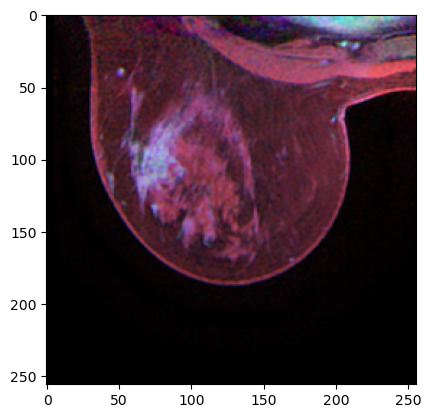

In [268]:
dostop=0
for i, row in df[df.dataset == 'spy2'].iterrows():
    
    nitems = int(row['n_times'])
    pid=row['pid']
    
    n_z=int(row['n_z'])
    n_xy=int(row['n_xy'])
    #ACRIN-6698-102212_spy2_vis1_mask.nii
    f=os.path.join(bpath,pid,'mask',pid+'_spy2_vis1_mask.nii.gz')
    print(f, ' is_file ',os.path.isfile(f))
    m = read_nifti(f) 
    print(pid,'mask',m.shape)
    a=[]
    for k in range(nitems):
        #ACRIN-6698-102212_spy2_vis1_dce_aqc_0.nii.gz
        f=os.path.join(bpath,pid,'dce',pid+'_spy2_vis1_dce_aqc_'+str(int(k))+'.nii.gz')
        print(f, ' is_file ',os.path.isfile(f))
        if True:
            im = read_nifti(f)
            a.append(im)
                 
            if im.shape!=m.shape:
                print('Z not same','im',im.shape,' mask', m.shape, f)
                dostop=1
                break
            if im.shape[0]!=n_z:
                print('Z not same',im.shape, n_z)
                dostop=1
                break
                df.at[i,'remarks']='Z not same'
            if im.shape[1]!=n_xy:
                print('XY not same',im.shape, n_xy)
                dostop=1
                df.at[i,'remarks']='Z not same'
            
        
    print(dostop)            
    if dostop:
        break
    a0=a[int(row['pre'])]
    a1=a[int(row['post_early'])]
    a2=a[int(row['post_late'])]
    print(a0.shape,a1.shape,a2.shape)
    k=get_max_plane(m)
    mfname = pid+'_'+str(k)+'.png'
    
    imf = np.zeros((a0.shape[1],
                            a0.shape[1], 3), np.float64)
            
            
    imf[:,:,0] = minmax(a0[k])
    imf[:,:,1] = minmax(a1[k])
    imf[:,:,2] = minmax(a2[k])

    imf = (imf*255).astype(np.uint8)                                                                      
    plt.imshow(imf)            
    mmn = pid+'_'+str(k)+'.png'
    mm_m = pid+'_'+str(k)+'_mask.png'
    mm_wm = pid+'_'+str(k)+'_with_mask.png'
    
    imm_wm = imf.copy()
    imm_wm[:,:,0]=((m[k]/m[k].max())*255).astype(np.uint8)
    
    float_array = m[k]  # your float32 image


    scaled = (255 * (float_array - float_array.min()) / (float_array.ptp())).astype(np.uint8)
    Image.fromarray(scaled).save(os.path.join(rdir, mm_m))


    print('saving:',os.path.join(rdir,   mmn))
    Image.fromarray(imf).save(os.path.join(rdir,   mmn))
    
    Image.fromarray(imm_wm).save(os.path.join(rdir,   mm_wm))
                 
    '''plt.imsave(os.path.join(sample_dir,   mmn), imf)
    plt.imsave(os.path.join(sample_dir,   mm_m), m[k])
    plt.imsave(os.path.join(sample_dir,   mm_wm), imm_wm)    '''                                                        
        

In [254]:
os.listdir('..\\PKG - BreastDCEDL_ISPY2\\BreastDCEDL_ISPY2\\ACRIN-6698-102212\\dce')

['ACRIN-6698-102212_spy2_vis1_dce_aqc_0.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_1.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_2.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_3.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_4.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_5.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_6.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_7.nii.gz']

In [256]:
os.listdir('..\\PKG - BreastDCEDL_ISPY2\\BreastDCEDL_ISPY2\\ACRIN-6698-102212\\dce\\')

['ACRIN-6698-102212_spy2_vis1_dce_aqc_0.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_1.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_2.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_3.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_4.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_5.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_6.nii.gz',
 'ACRIN-6698-102212_spy2_vis1_dce_aqc_7.nii.gz']